# Problem Statement

iPrint, an upcoming Indian media house that offers media and information services to the people, has decided to begin providing a more personalised experience to its customers. The company’s business extends across a wide range of media, including news and information services on sports, weather, education, health, research, stocks and healthcare.

iPrint has been managing its customer base by only recommending the most popular and similar news articles to its users. However, the recommended news articles are often not relevant to the majority of the users. And the company is not able to recommend any new content to its customers, and gradually, the company sthas started to lose such users, resulting in immense revenue loss.

In order to stay healthy in the market, iPrint needs to stay updated with time an technology advancements.


# Suggestion

A probable solution for the company to compete with other competitors is to solve the issue of revenue leakage by personalising users' tastes and introducing new content to its users at the start of the day on the home page of the application.


# Solution

##### Building a NEWS RECOMMENDATION SYSTEM that does below:

--> Recommend new top 10 relevant articles to a user when he/she visits the app at the start of the day

--> Recommend top 10 similar news articles that match the ones clicked by the user.

The articles that are written in the English language must be considered.

## 1. Data Pre-Processing

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
pd.set_option('display.max_rows', 50000)
pd.set_option('display.max_columns', 50000)

In [3]:
consumer_ds = pd.read_csv('data/consumer_transanctions.csv', low_memory=False)

In [4]:
platform_ds = pd.read_csv('data/platform_content.csv')

In [5]:
consumer_ds.head()

,event_timestamp,interaction_type,item_id,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country
0,1465413032,content_watched,-3499919498720038879,-8845298781299428018,1264196770339959068,NaN,NaN,NaN
1,1465412560,content_watched,8890720798209849691,-1032019229384696495,3621737643587579081,Mozilla/5.0 (Macintosh; Intel Mac OS X 10_11_2...,NY,US
2,1465416190,content_watched,310515487419366995,-1130272294246983140,2631864456530402479,NaN,NaN,NaN
3,1465413895,content_followed,310515487419366995,344280948527967603,-3167637573980064150,NaN,NaN,NaN
4,1465412290,content_watched,-7820640624231356730,-445337111692715325,561148 1178424124714,NaN,NaN,NaN


In [6]:
platform_ds.head()

,event_timestamp,interaction_type,item_id,producer_id,producer_session_id,producer_device_info,producer_location,producer_country,item_type,item_url,title,text_description,language
0,1459192779,content_pulled_out,-6451309518266745024,4340306774493623681,8940341205206233829,NaN,NaN,NaN,HTML,http://www.nytimes.com/2016/03/28/business/dea...,"Ethereum, a Virtual Currency, Enables Transact...",All of this work is still very early. The firs...,en
1,1459193988,content_present,-4110354420726924665,4340306774493623681,8940341205206233829,NaN,NaN,NaN,HTML,http://www.nytimes.com/2016/03/28/business/dea...,"Ethereum, a Virtual Currency, Enables Transact...",All of this work is still very early. The firs...,en
2,1459194146,content_present,-7292285110016212249,4340306774493623681,8940341205206233829,NaN,NaN,NaN,HTML,http://cointelegraph.com/news/bitcoin-future-w...,Bitcoin Future: When GBPcoin of Branson Wins O...,The alarm clock wakes me at 8:00 with stream o...,en
3,1459194474,content_present,-6151852268067518688,3891637997717104548,-1457532940883382585,NaN,NaN,NaN,HTML,https://cloudplatform.googleblog.com/2016/03/G...,Google Data Center 360° Tour,We're excited to share the Google Data Center ...,en
4,1459194497,content_present,2448026894306402386,4340306774493623681,8940341205206233829,NaN,NaN,NaN,HTML,https://bitcoinmagazine.com/articles/ibm-wants...,"IBM Wants to ""Evolve the Internet"" With Blockc...",The Aite Group projects the blockchain market ...,en


#### Increase column width to see Keywords values properly

In [7]:
pd.set_option('max_colwidth', None)

In [8]:
consumer_ds.head(2)

,event_timestamp,interaction_type,item_id,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country
0,1465413032,content_watched,-3499919498720038879,-8845298781299428018,1264196770339959068,NaN,NaN,NaN
1,1465412560,content_watched,8890720798209849691,-1032019229384696495,3621737643587579081,"Mozilla/5.0 (Macintosh; Intel Mac OS X 10_11_2) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/52.0.2743.24 Safari/537.36",NY,US


In [9]:
platform_ds.head(2)

event_timestamp    interaction_type              item_id  \
0       1459192779  content_pulled_out -6451309518266745024   
1       1459193988     content_present -4110354420726924665   

           producer_id  producer_session_id producer_device_info  \
0  4340306774493623681  8940341205206233829                  NaN   
1  4340306774493623681  8940341205206233829                  NaN   

  producer_location producer_country item_type  \
0               NaN              NaN      HTML   
1               NaN              NaN      HTML   

                                                                                                                        item_url  \
0  http://www.nytimes.com/2016/03/28/business/dealbook/ethereum-a-virtual-currency-enables-transactions-that-rival-bitcoins.html   
1  http://www.nytimes.com/2016/03/28/business/dealbook/ethereum-a-virtual-currency-enables-transactions-that-rival-bitcoins.html   

                                                                     title  \
0  Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's   
1  Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         

In [10]:
consumer_ds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 72312 entries, 0 to 72311
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   event_timestamp       72312 non-null  int64 
 1   interaction_type      72312 non-null  object
 2   item_id               72312 non-null  int64 
 3   consumer_id           72312 non-null  int64 
 4   consumer_session_id   72312 non-null  object
 5   consumer_device_info  56918 non-null  object
 6   consumer_location     56907 non-null  object
 7   country               56918 non-null  object
dtypes: int64(3), object(5)
memory usage: 4.4+ MB


In [11]:
consumer_ds.shape

(72312, 8)

##### Imputing 'Rating' values on the feature 'interaction_type' - numeric

In [12]:
consumer_ds.interaction_type.nunique()

5

In [13]:
consumer_ds['interaction_type'].unique()

array(['content_watched', 'content_followed', 'content_saved',
       'content_liked', 'content_commented_on'], dtype=object)

In [14]:
consumer_ds['interaction_type'].value_counts()

content_watched         61086
content_liked            5745
content_saved            2463
content_commented_on     1611
content_followed         1407
Name: interaction_type, dtype: int64

In [15]:
# Defining the function for Imputing
def ratings(x):
    if x == 'content_followed':
        return 5
    elif x == 'content_commented_on':
        return 4
    elif x == 'content_saved':
        return 3
    elif x == 'content_liked':
        return 2
    elif x == 'content_watched':
        return 1
        
consumer_ds['Ratings'] = consumer_ds['interaction_type'].apply(lambda x: ratings(x))

In [16]:
consumer_ds.head()

,event_timestamp,interaction_type,item_id,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country,Ratings
0,1465413032,content_watched,-3499919498720038879,-8845298781299428018,1264196770339959068,NaN,NaN,NaN,1
1,1465412560,content_watched,8890720798209849691,-1032019229384696495,3621737643587579081,"Mozilla/5.0 (Macintosh; Intel Mac OS X 10_11_2) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/52.0.2743.24 Safari/537.36",NY,US,1
2,1465416190,content_watched,310515487419366995,-1130272294246983140,2631864456530402479,NaN,NaN,NaN,1
3,1465413895,content_followed,310515487419366995,344280948527967603,-3167637573980064150,NaN,NaN,NaN,5
4,1465412290,content_watched,-7820640624231356730,-445337111692715325,561148 1178424124714,NaN,NaN,NaN,1


In [17]:
consumer_ds['Ratings'].value_counts()

1    61086
2     5745
3     2463
4     1611
5     1407
Name: Ratings, dtype: int64

In [18]:
consumer_ds.describe()

,event_timestamp,item_id,consumer_id,Ratings
count,7.231200e+04,7.231200e+04,7.231200e+04,72312.000000
mean,1.470103e+09,-3.033423e+16,1.252026e+16,1.292234
std,7.258130e+06,5.344755e+18,5.022333e+18,0.801325
min,1.457964e+09,-9.222795e+18,-9.223122e+18,1.000000
25%,1.464876e+09,-4.726309e+18,-3.596627e+18,1.000000
50%,1.468343e+09,1.893099e+16,-1.088422e+17,1.000000
75%,1.474461e+09,4.441012e+18,3.766319e+18,1.000000
max,1.488310e+09,9.222265e+18,9.210531e+18,5.000000


#### Platform Dataset Analysis on Keywords Column

In [19]:
platform_ds.shape

(3122, 13)

In [20]:
platform_ds.language.nunique()

5

In [21]:
platform_ds['language'].unique()

array(['en', 'pt', 'es', 'la', 'ja'], dtype=object)

In [22]:
platform_ds1 = platform_ds[platform_ds['language']=='en']

In [23]:
platform_ds1['language'].unique()

array(['en'], dtype=object)

In [24]:
platform_ds1.head(2)

event_timestamp    interaction_type              item_id  \
0       1459192779  content_pulled_out -6451309518266745024   
1       1459193988     content_present -4110354420726924665   

           producer_id  producer_session_id producer_device_info  \
0  4340306774493623681  8940341205206233829                  NaN   
1  4340306774493623681  8940341205206233829                  NaN   

  producer_location producer_country item_type  \
0               NaN              NaN      HTML   
1               NaN              NaN      HTML   

                                                                                                                        item_url  \
0  http://www.nytimes.com/2016/03/28/business/dealbook/ethereum-a-virtual-currency-enables-transactions-that-rival-bitcoins.html   
1  http://www.nytimes.com/2016/03/28/business/dealbook/ethereum-a-virtual-currency-enables-transactions-that-rival-bitcoins.html   

                                                                     title  \
0  Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's   
1  Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         

In [25]:
platform_ds1.shape

(2264, 13)

## 2. Exploratory Data Analysis

In [26]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

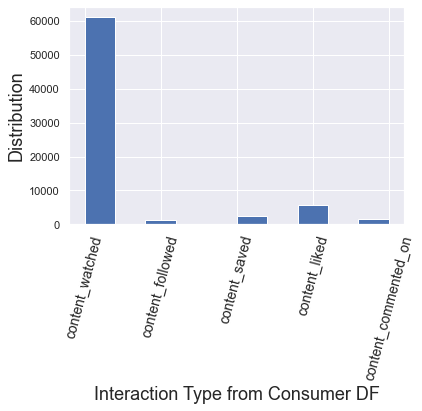

In [27]:
plt.hist(consumer_ds.interaction_type)
plt.xlabel('Interaction Type from Consumer DF', fontsize=18)
plt.ylabel('Distribution', fontsize=18)
plt.xticks(rotation=75, fontsize=14)
plt.show()

##### As visible from above histogram, the most comment interaction type for users on the app is 'content_watched', following by some 'content_liked'

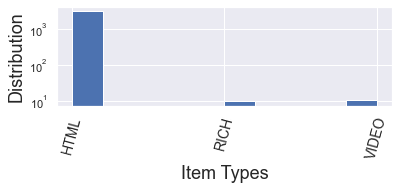

In [28]:
fig = plt.figure()
ax = fig.add_subplot(2, 1, 1)
ax.set_yscale('log')
plt.hist(platform_ds.item_type)
plt.xlabel('Item Types', fontsize=18)
plt.ylabel('Distribution', fontsize=18)
plt.xticks(rotation=75, fontsize=14)
plt.show()

##### As visible from above histogram, the most comment item type is 'HTML'

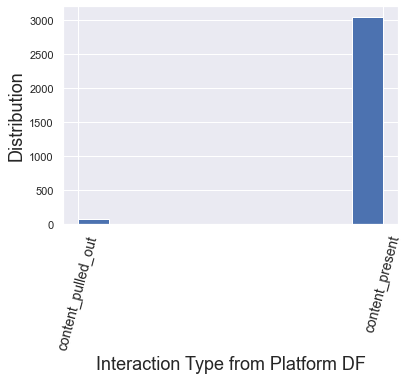

In [29]:
plt.hist(platform_ds.interaction_type)
plt.xlabel('Interaction Type from Platform DF', fontsize=18)
plt.ylabel('Distribution', fontsize=18)
plt.xticks(rotation=75, fontsize=14)
plt.show()

##### As visible from above histogram, the most comment interaction type from (platform dataset) is 'content_present'

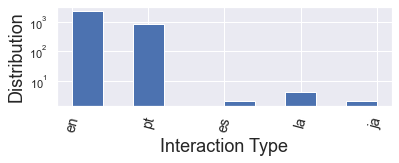

In [30]:
fig = plt.figure()
ax = fig.add_subplot(2, 1, 1)
ax.set_yscale('log')
plt.hist(platform_ds.language)
plt.xlabel('Interaction Type', fontsize=18)
plt.ylabel('Distribution', fontsize=18)
plt.xticks(rotation=75, fontsize=14)
plt.show()

##### As visible from above histogram, the most comment language of users is 'en', that is, English followed by 'pt' for Portuguese


### Some Bar Graph Plots

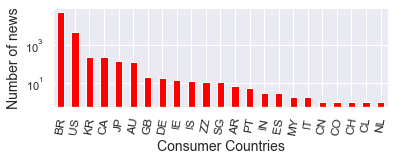

In [31]:
fig = plt.figure()
ax = fig.add_subplot(2, 1, 1)
ax.set_yscale('log')
country=consumer_ds.country
country.value_counts().plot(kind='bar', color='red')
plt.xlabel('Consumer Countries', fontsize=14)
plt.ylabel('Number of news', fontsize=14)
plt.xticks(rotation=80, fontsize=12)
plt.show()

In [32]:
consumer_ds['device_name'] = consumer_ds.consumer_device_info.str.split().str.get(0)

In [33]:
consumer_ds.head()

,event_timestamp,interaction_type,item_id,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country,Ratings,device_name
0,1465413032,content_watched,-3499919498720038879,-8845298781299428018,1264196770339959068,NaN,NaN,NaN,1,NaN
1,1465412560,content_watched,8890720798209849691,-1032019229384696495,3621737643587579081,"Mozilla/5.0 (Macintosh; Intel Mac OS X 10_11_2) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/52.0.2743.24 Safari/537.36",NY,US,1,Mozilla/5.0
2,1465416190,content_watched,310515487419366995,-1130272294246983140,2631864456530402479,NaN,NaN,NaN,1,NaN
3,1465413895,content_followed,310515487419366995,344280948527967603,-3167637573980064150,NaN,NaN,NaN,5,NaN
4,1465412290,content_watched,-7820640624231356730,-445337111692715325,561148 1178424124714,NaN,NaN,NaN,1,NaN


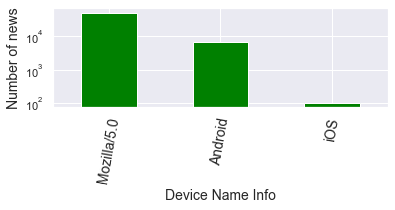

In [34]:
fig = plt.figure()
ax = fig.add_subplot(2, 1, 1)
ax.set_yscale('log')
device_n=consumer_ds.device_name
device_n.value_counts().plot(kind='bar', color='green')
plt.xlabel('Device Name Info', fontsize=14)
plt.ylabel('Number of news', fontsize=14)
plt.xticks(rotation=80, fontsize=14)
plt.show()

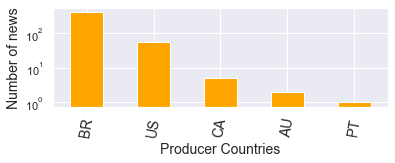

In [35]:
fig = plt.figure()
ax = fig.add_subplot(2, 1, 1)
ax.set_yscale('log')
prod_country=platform_ds1.producer_country
prod_country.value_counts().plot(kind='bar', color='orange')
plt.xlabel('Producer Countries', fontsize=14)
plt.ylabel('Number of news', fontsize=14)
plt.xticks(rotation=80, fontsize=14)
plt.show()

In [36]:
# Interaction Type --> Ratings Calculation

interact_ds1 = consumer_ds['interaction_type'].value_counts()*100/consumer_ds.shape[0]

In [37]:
interact_ds = pd.DataFrame(interact_ds1)

In [38]:
interact_ds.reset_index(inplace=True)

In [39]:
interact_ds.columns = ['interaction_type', 'value']
interact_ds

,interaction_type,value
0,content_watched,84.475606
1,content_liked,7.944739
2,content_saved,3.406074
3,content_commented_on,2.227846
4,content_followed,1.945735


In [40]:
# Rating Value

interact_ds['rating'] = 100/interact_ds['value']
interact_ds

,interaction_type,value,rating
0,content_watched,84.475606,1.183774
1,content_liked,7.944739,12.586945
2,content_saved,3.406074,29.359318
3,content_commented_on,2.227846,44.886406
4,content_followed,1.945735,51.394456


In [41]:
user_rating = pd.merge(consumer_ds, interact_ds, on='interaction_type', how='left')

In [42]:
user_rating = user_rating[['consumer_id', 'item_id', 'rating']]

In [43]:
user_rating.drop_duplicates(inplace=True)
user_rating.shape

(50938, 3)

In [44]:
user_rating.head(3)

,consumer_id,item_id,rating
0,-8845298781299428018,-3499919498720038879,1.183774
1,-1032019229384696495,8890720798209849691,1.183774
2,-1130272294246983140,310515487419366995,1.183774


In [45]:
user_rating['news_id'] = user_rating.groupby(['item_id']).ngroup()

In [46]:
user_rating['user_id'] = user_rating.groupby(['consumer_id']).ngroup()

In [47]:
user_rating.head(3)

,consumer_id,item_id,rating,news_id,user_id
0,-8845298781299428018,-3499919498720038879,1.183774,933,33
1,-1032019229384696495,8890720798209849691,1.183774,2933,831
2,-1130272294246983140,310515487419366995,1.183774,1537,826


In [48]:
ratings_ds = user_rating[['user_id','news_id','rating']]

In [49]:
ratings_ds.head(3)

,user_id,news_id,rating
0,33,933,1.183774
1,831,2933,1.183774
2,826,1537,1.183774


# 3. Collaborative Filtering: User Based Recommendations

In [50]:
consumer_ds.head()

,event_timestamp,interaction_type,item_id,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country,Ratings,device_name
0,1465413032,content_watched,-3499919498720038879,-8845298781299428018,1264196770339959068,NaN,NaN,NaN,1,NaN
1,1465412560,content_watched,8890720798209849691,-1032019229384696495,3621737643587579081,"Mozilla/5.0 (Macintosh; Intel Mac OS X 10_11_2) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/52.0.2743.24 Safari/537.36",NY,US,1,Mozilla/5.0
2,1465416190,content_watched,310515487419366995,-1130272294246983140,2631864456530402479,NaN,NaN,NaN,1,NaN
3,1465413895,content_followed,310515487419366995,344280948527967603,-3167637573980064150,NaN,NaN,NaN,5,NaN
4,1465412290,content_watched,-7820640624231356730,-445337111692715325,561148 1178424124714,NaN,NaN,NaN,1,NaN


In [51]:
consumer_ds.item_id.nunique()

2987

In [52]:
# Test and Train split of the dataset.
from sklearn.model_selection import train_test_split
train, test = train_test_split(consumer_ds, test_size=0.30, random_state=31)

In [53]:
print(train.shape)
print(test.shape)

(50618, 10)
(21694, 10)


In [54]:
# Pivot the train ratings' dataset into matrix format in which columns are item IDs and the rows are user IDs.
df_pivot = train.pivot_table(
    index='consumer_id',
    columns='item_id',
    values='Ratings'
).fillna(0)

df_pivot.head()

item_id               -9222795471790223670  -9216926795620865886  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   1.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9194572880052200111  -9192549002213406534  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9190737901804729417  -9189659052158407108  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9184137057748005562  -9176143510534135851  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9172673334835262304  -9171475473795142532  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9166778629773133902  -9161596996229760398  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9160910454530522563  -9157338616628196758  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9153494109165200346  -9147114693160126293  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9137036168156595470  -9128741757954228992  \
consumer_id                                                        
-9223121837663643404                   0.0      

In [55]:
df_pivot.shape

(1815, 2917)

In [56]:
# Copy the train dataset into dummy_train
dummy_train = train.copy()

In [57]:
dummy_train.head(2)

,event_timestamp,interaction_type,item_id,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country,Ratings,device_name
1725,1462892180,content_watched,-205193648629294862,6644119361202586331,-4325343075144702769,"Mozilla/5.0 (Windows NT 6.1; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/50.0.2661.94 Safari/537.36",SP,BR,1,Mozilla/5.0
254,1463360317,content_watched,-6858240061363309239,-5823562314929634489,-3144035296667611204,"Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/50.0.2661.102 Safari/537.36",MG,BR,1,Mozilla/5.0


In [58]:
# The movies not rated by user is marked as 1 for prediction. 
dummy_train['Ratings'] = dummy_train['Ratings'].apply(lambda x: 0 if x>=1 else 1)

In [59]:
# Convert the dummy train dataset into matrix format.
dummy_train = dummy_train.pivot_table(
    index='consumer_id',
    columns='item_id',
    values='Ratings'
).fillna(1)

In [60]:
dummy_train.head()

item_id               -9222795471790223670  -9216926795620865886  \
consumer_id                                                        
-9223121837663643404                   1.0                   1.0   
-9212075797126931087                   1.0                   1.0   
-9207251133131336884                   1.0                   0.0   
-9199575329909162940                   1.0                   1.0   
-9196668942822132778                   1.0                   1.0   

item_id               -9194572880052200111  -9192549002213406534  \
consumer_id                                                        
-9223121837663643404                   1.0                   1.0   
-9212075797126931087                   1.0                   1.0   
-9207251133131336884                   1.0                   1.0   
-9199575329909162940                   1.0                   1.0   
-9196668942822132778                   1.0                   1.0   

item_id               -9190737901804729417  -9189659052158407108  \
consumer_id                                                        
-9223121837663643404                   1.0                   1.0   
-9212075797126931087                   1.0                   1.0   
-9207251133131336884                   1.0                   1.0   
-9199575329909162940                   1.0                   1.0   
-9196668942822132778                   1.0                   1.0   

item_id               -9184137057748005562  -9176143510534135851  \
consumer_id                                                        
-9223121837663643404                   1.0                   1.0   
-9212075797126931087                   1.0                   1.0   
-9207251133131336884                   1.0                   1.0   
-9199575329909162940                   1.0                   1.0   
-9196668942822132778                   1.0                   1.0   

item_id               -9172673334835262304  -9171475473795142532  \
consumer_id                                                        
-9223121837663643404                   1.0                   1.0   
-9212075797126931087                   1.0                   1.0   
-9207251133131336884                   1.0                   1.0   
-9199575329909162940                   1.0                   1.0   
-9196668942822132778                   1.0                   1.0   

item_id               -9166778629773133902  -9161596996229760398  \
consumer_id                                                        
-9223121837663643404                   1.0                   1.0   
-9212075797126931087                   1.0                   1.0   
-9207251133131336884                   1.0                   1.0   
-9199575329909162940                   1.0                   1.0   
-9196668942822132778                   1.0                   1.0   

item_id               -9160910454530522563  -9157338616628196758  \
consumer_id                                                        
-9223121837663643404                   1.0                   1.0   
-9212075797126931087                   1.0                   1.0   
-9207251133131336884                   1.0                   1.0   
-9199575329909162940                   1.0                   1.0   
-9196668942822132778                   1.0                   1.0   

item_id               -9153494109165200346  -9147114693160126293  \
consumer_id                                                        
-9223121837663643404                   1.0                   1.0   
-9212075797126931087                   1.0                   1.0   
-9207251133131336884                   1.0                   1.0   
-9199575329909162940                   1.0                   1.0   
-9196668942822132778                   1.0                   1.0   

item_id               -9137036168156595470  -9128741757954228992  \
consumer_id                                                        
-9223121837663643404                   1.0      

# User Similarity Matrix

## Using Cosine Similarity

In [61]:
df_pivot.index.nunique()

1815

In [62]:
from sklearn.metrics.pairwise import pairwise_distances

# Creating the User Similarity Matrix using pairwise_distance function.
user_correlation = 1 - pairwise_distances(df_pivot, metric='cosine')
user_correlation[np.isnan(user_correlation)] = 0
print(user_correlation)

[[1.         0.         0.         ... 0.         0.0556846  0.03012271]
 [0.         1.         0.15749532 ... 0.         0.         0.        ]
 [0.         0.15749532 1.         ... 0.2975674  0.19019367 0.        ]
 ...
 [0.         0.         0.2975674  ... 1.         0.10203583 0.        ]
 [0.0556846  0.         0.19019367 ... 0.10203583 1.         0.        ]
 [0.03012271 0.         0.         ... 0.         0.         1.        ]]


In [63]:
user_correlation.shape

(1815, 1815)

## Using adjusted Cosine 

### Here, we are not removing the NaN values and calculating the mean only for the news rated by the user

In [64]:
# Create a user-movie matrix.
df_pivot = train.pivot_table(
    index='consumer_id',
    columns='item_id',
    values='Ratings'
)

In [65]:
df_pivot.head()

item_id               -9222795471790223670  -9216926795620865886  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   1.0   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9194572880052200111  -9192549002213406534  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9190737901804729417  -9189659052158407108  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9184137057748005562  -9176143510534135851  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9172673334835262304  -9171475473795142532  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9166778629773133902  -9161596996229760398  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9160910454530522563  -9157338616628196758  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9153494109165200346  -9147114693160126293  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9137036168156595470  -9128741757954228992  \
consumer_id                                                        
-9223121837663643404                   NaN      

In [66]:
mean = np.nanmean(df_pivot, axis=1)
df_subtracted = (df_pivot.T-mean).T

In [67]:
df_subtracted.head()

item_id               -9222795471790223670  -9216926795620865886  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN              -0.47619   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9194572880052200111  -9192549002213406534  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9190737901804729417  -9189659052158407108  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9184137057748005562  -9176143510534135851  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9172673334835262304  -9171475473795142532  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9166778629773133902  -9161596996229760398  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9160910454530522563  -9157338616628196758  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9153494109165200346  -9147114693160126293  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9137036168156595470  -9128741757954228992  \
consumer_id                                                        
-9223121837663643404                   NaN      

### Finding cosine similarity

In [68]:
from sklearn.metrics.pairwise import pairwise_distances

# Creating the User Similarity Matrix using pairwise_distance function.
user_correlation = 1 - pairwise_distances(df_subtracted.fillna(0), metric='cosine')
user_correlation[np.isnan(user_correlation)] = 0
print(user_correlation)

[[ 1.          0.          0.         ...  0.          0.
   0.00414714]
 [ 0.          1.         -0.28988552 ...  0.          0.
   0.        ]
 [ 0.         -0.28988552  1.         ... -0.01985099  0.
   0.        ]
 ...
 [ 0.          0.         -0.01985099 ...  1.          0.
   0.        ]
 [ 0.          0.          0.         ...  0.          0.
   0.        ]
 [ 0.00414714  0.          0.         ...  0.          0.
   1.        ]]


In [69]:
user_correlation.shape

(1815, 1815)

## Prediction - User User


In [70]:
user_correlation[user_correlation<0]=0
user_correlation

array([[1.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.00414714],
       [0.        , 1.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 1.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 1.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.00414714, 0.        , 0.        , ..., 0.        , 0.        ,
        1.        ]])

In [71]:
user_predicted_ratings = np.dot(user_correlation, df_pivot.fillna(0))
user_predicted_ratings

array([[0.01024361, 0.03078322, 0.01620902, ..., 0.00424412, 0.01097039,
        0.        ],
       [0.01953155, 1.56798967, 0.0032167 , ..., 0.02015276, 0.013669  ,
        0.        ],
       [0.02525702, 1.79997733, 0.39103094, ..., 0.03351159, 0.27005562,
        0.        ],
       ...,
       [0.        , 0.05530013, 0.07458524, ..., 0.        , 0.03959657,
        0.00809934],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.00934557, 0.        , 0.12275724, ..., 0.00862289, 0.09991645,
        0.00300108]])

In [72]:
user_predicted_ratings.shape

(1815, 2917)

In [73]:
user_predicted_ratings

array([[0.01024361, 0.03078322, 0.01620902, ..., 0.00424412, 0.01097039,
        0.        ],
       [0.01953155, 1.56798967, 0.0032167 , ..., 0.02015276, 0.013669  ,
        0.        ],
       [0.02525702, 1.79997733, 0.39103094, ..., 0.03351159, 0.27005562,
        0.        ],
       ...,
       [0.        , 0.05530013, 0.07458524, ..., 0.        , 0.03959657,
        0.00809934],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.00934557, 0.        , 0.12275724, ..., 0.00862289, 0.09991645,
        0.00300108]])

In [74]:
user_final_rating = np.multiply(user_predicted_ratings,dummy_train)
user_final_rating.head()

item_id               -9222795471790223670  -9216926795620865886  \
consumer_id                                                        
-9223121837663643404              0.010244              0.030783   
-9212075797126931087              0.019532              1.567990   
-9207251133131336884              0.025257              0.000000   
-9199575329909162940              0.030435              0.005941   
-9196668942822132778              0.000000              0.000000   

item_id               -9194572880052200111  -9192549002213406534  \
consumer_id                                                        
-9223121837663643404              0.016209              0.037489   
-9212075797126931087              0.003217              0.017857   
-9207251133131336884              0.391031              1.027720   
-9199575329909162940              0.002978              0.023755   
-9196668942822132778              0.000000              0.000000   

item_id               -9190737901804729417  -9189659052158407108  \
consumer_id                                                        
-9223121837663643404              0.000000              0.020862   
-9212075797126931087              0.000000              0.619878   
-9207251133131336884              0.000000              0.032033   
-9199575329909162940              0.022994              0.013292   
-9196668942822132778              0.000000              0.000000   

item_id               -9184137057748005562  -9176143510534135851  \
consumer_id                                                        
-9223121837663643404                   0.0              0.019963   
-9212075797126931087                   0.0              0.029891   
-9207251133131336884                   0.0              0.340028   
-9199575329909162940                   0.0              0.040945   
-9196668942822132778                   0.0              0.000000   

item_id               -9172673334835262304  -9171475473795142532  \
consumer_id                                                        
-9223121837663643404              0.004379              0.011308   
-9212075797126931087              0.000000              0.000000   
-9207251133131336884              0.000000              0.000000   
-9199575329909162940              0.000000              0.013842   
-9196668942822132778              0.000000              0.000000   

item_id               -9166778629773133902  -9161596996229760398  \
consumer_id                                                        
-9223121837663643404              0.004152              0.008456   
-9212075797126931087              0.000000              0.000000   
-9207251133131336884              0.080459              0.010551   
-9199575329909162940              0.000000              0.005864   
-9196668942822132778              0.000000              0.000000   

item_id               -9160910454530522563  -9157338616628196758  \
consumer_id                                                        
-9223121837663643404              0.023528              0.003769   
-9212075797126931087              0.008878              0.000000   
-9207251133131336884              0.248862              0.000000   
-9199575329909162940              0.010810              0.003072   
-9196668942822132778              0.000000              0.000000   

item_id               -9153494109165200346  -9147114693160126293  \
consumer_id                                                        
-9223121837663643404              0.004379              0.003084   
-9212075797126931087              0.000000              0.004541   
-9207251133131336884              0.000000              0.000000   
-9199575329909162940              0.000000              0.003095   
-9196668942822132778              0.000000              0.000000   

item_id               -9137036168156595470  -9128741757954228992  \
consumer_id                                                        
-9223121837663643404              0.301255      

### Finding the top 10 news recommendation for the user

In [75]:
# Take the user ID as input

# Taking 1st userID from above list

user_input = int(input("Enter your user name"))
print(user_input)

Enter your user name-9223121837663643404
-9223121837663643404


In [76]:
user_final_rating.head(7)

item_id               -9222795471790223670  -9216926795620865886  \
consumer_id                                                        
-9223121837663643404              0.010244              0.030783   
-9212075797126931087              0.019532              1.567990   
-9207251133131336884              0.025257              0.000000   
-9199575329909162940              0.030435              0.005941   
-9196668942822132778              0.000000              0.000000   
-9188188261933657343              0.000000              0.000000   
-9172914609055320039              0.000000              0.000000   

item_id               -9194572880052200111  -9192549002213406534  \
consumer_id                                                        
-9223121837663643404              0.016209              0.037489   
-9212075797126931087              0.003217              0.017857   
-9207251133131336884              0.391031              1.027720   
-9199575329909162940              0.002978              0.023755   
-9196668942822132778              0.000000              0.000000   
-9188188261933657343              0.000000              0.000000   
-9172914609055320039              0.000000              0.000000   

item_id               -9190737901804729417  -9189659052158407108  \
consumer_id                                                        
-9223121837663643404              0.000000              0.020862   
-9212075797126931087              0.000000              0.619878   
-9207251133131336884              0.000000              0.032033   
-9199575329909162940              0.022994              0.013292   
-9196668942822132778              0.000000              0.000000   
-9188188261933657343              0.000000              0.000000   
-9172914609055320039              0.000000              0.000000   

item_id               -9184137057748005562  -9176143510534135851  \
consumer_id                                                        
-9223121837663643404                   0.0              0.019963   
-9212075797126931087                   0.0              0.029891   
-9207251133131336884                   0.0              0.340028   
-9199575329909162940                   0.0              0.040945   
-9196668942822132778                   0.0              0.000000   
-9188188261933657343                   0.0              0.000000   
-9172914609055320039                   0.0              0.000000   

item_id               -9172673334835262304  -9171475473795142532  \
consumer_id                                                        
-9223121837663643404              0.004379              0.011308   
-9212075797126931087              0.000000              0.000000   
-9207251133131336884              0.000000              0.000000   
-9199575329909162940              0.000000              0.013842   
-9196668942822132778              0.000000              0.000000   
-9188188261933657343              0.000000              0.000000   
-9172914609055320039              0.000000              0.000000   

item_id               -9166778629773133902  -9161596996229760398  \
consumer_id                                                        
-9223121837663643404              0.004152              0.008456   
-9212075797126931087              0.000000              0.000000   
-9207251133131336884              0.080459              0.010551   
-9199575329909162940              0.000000              0.005864   
-9196668942822132778              0.000000              0.000000   
-9188188261933657343              0.000000              0.000000   
-9172914609055320039              0.000000              0.000000   

item_id               -9160910454530522563  -9157338616628196758  \
consumer_id                                                        
-9223121837663643404              0.023528              0.003769   
-9212075797126931087              0.008878              0.000000   
-9207251133131336884              0.248862        

In [77]:
d = user_final_rating.loc[user_input].sort_values(ascending=False)[0:10]
d

item_id
-5813211845057621660    1.008880
 569574447134368517     0.999032
 9175693555063886126    0.879710
-8627051188605351707    0.867420
 2930191803881821526    0.850632
 2362495898257544462    0.848988
-2923886912694084893    0.827211
 1469580151036142903    0.821791
-6340141548068597572    0.817818
-3482581255202910790    0.814551
Name: -9223121837663643404, dtype: float64

In [78]:
d2 = consumer_ds[['item_id', 'consumer_id']]

In [79]:
item_user_pair = pd.merge(d, d2, on = 'item_id', how='left')

In [80]:
item_user_pair

,item_id,-9223121837663643404,consumer_id
0,-5813211845057621660,1.008880,5321535590192312132
1,-5813211845057621660,1.008880,-3416264867487266035
2,-5813211845057621660,1.008880,-1119397949556155765
3,-5813211845057621660,1.008880,-8336698712796133957
4,-5813211845057621660,1.008880,-4246695160507476121
5,-5813211845057621660,1.008880,8698209668239173600
6,-5813211845057621660,1.008880,-1694477146133918626
7,-5813211845057621660,1.008880,-4246040813531967142
8,-5813211845057621660,1.008880,953707509720613429
9,-5813211845057621660,1.008880,-1863544689523892600


In [81]:
d3 = pd.merge(d,consumer_ds,left_on='item_id',right_on='item_id', how = 'left')
d3

,item_id,-9223121837663643404,event_timestamp,interaction_type,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country,Ratings,device_name
0,-5813211845057621660,1.008880,1484916779,content_watched,5321535590192312132,-5916139805775449415,"Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/54.0.2840.90 Safari/537.36",MG,BR,1,Mozilla/5.0
1,-5813211845057621660,1.008880,1484920912,content_watched,-3416264867487266035,6562454120692848435,"Mozilla/5.0 (Windows NT 10.0; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/55.0.2883.87 Safari/537.36",TX,US,1,Mozilla/5.0
2,-5813211845057621660,1.008880,1484958286,content_watched,-1119397949556155765,1692990166127786179,"Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/55.0.2883.87 Safari/537.36",SP,BR,1,Mozilla/5.0
3,-5813211845057621660,1.008880,1485096904,content_watched,-8336698712796133957,-9136523227290503140,"Mozilla/5.0 (Macintosh; Intel Mac OS X 10_11_6) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/55.0.2883.95 Safari/537.36",SP,BR,1,Mozilla/5.0
4,-5813211845057621660,1.008880,1485185036,content_watched,-4246695160507476121,7168759783234899707,"Mozilla/5.0 (Macintosh; Intel Mac OS X 10_11_3) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/55.0.2883.95 Safari/537.36",CA,US,1,Mozilla/5.0
5,-5813211845057621660,1.008880,1486078562,content_watched,8698209668239173600,-4073043662413631080,"Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/55.0.2883.87 Safari/537.36",SP,BR,1,Mozilla/5.0
6,-5813211845057621660,1.008880,1485164714,content_watched,-1694477146133918626,-3177470406178986928,"Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/55.0.2883.87 Safari/537.36",SP,BR,1,Mozilla/5.0
7,-5813211845057621660,1.008880,1485166336,content_watched,-4246040813531967142,-4133641907407219374,"Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/50.0.2661.94 Safari/537.36",SP,BR,1,Mozilla/5.0
8,-5813211845057621660,1.008880,1485164493,content_watched,953707509720613429,-7650805014573071115,"Mozilla/5.0 (Windows NT 10.0; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/55.0.2883.87 Safari/537.36",SP,BR,1,Mozilla/5.0
9,-5813211845057621660,1.008880,1485164895,content_watched,-1863544689523892600,-115476466562230183,"Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/55.0.2883.87 Safari/537.36",SP,BR,1,Mozilla/5.0


# Evaluation - User User 

In [82]:
# Find out the common users of test and train dataset.
common = test[test.consumer_id.isin(train.consumer_id)]
common.shape

(21576, 10)

In [83]:
common.head()

,event_timestamp,interaction_type,item_id,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country,Ratings,device_name
42589,1469476310,content_liked,5445999759138709405,-7531858294361854119,2624608693925912718,NaN,NaN,NaN,2,NaN
12764,1461959859,content_liked,-6467708104873171151,-3596626804281480007,1112176729459344673,NaN,NaN,NaN,2,NaN
24508,1463498529,content_watched,-3759596852696130492,4313045637915476309,3681779508468526547,"Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/50.0.2661.94 Safari/537.36",SP,BR,1,Mozilla/5.0
53780,1473770997,content_liked,-6843047699859121724,-8424644554119645763,-2253271881556150864,NaN,NaN,NaN,2,NaN
7858,1465492901,content_watched,-5507019982244746725,3803524018159743904,-5869126609583858485,NaN,NaN,NaN,1,NaN


In [84]:
# convert into the user-movie matrix.
common_user_based_matrix = common.pivot_table(index='consumer_id', columns='item_id', values='Ratings')

In [85]:
common_user_based_matrix.head()

item_id               -9222795471790223670  -9216926795620865886  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   2.0   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9194572880052200111  -9192549002213406534  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9190737901804729417  -9189659052158407108  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9176143510534135851  -9171475473795142532  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9166778629773133902  -9161596996229760398  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9160910454530522563  -9157338616628196758  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9152398073968262186  -9147114693160126293  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9137036168156595470  -9128741757954228992  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9128652074338368262  -9107331682787867601  \
consumer_id                                                        
-9223121837663643404                   NaN      

In [86]:
# Convert the user_correlation matrix into dataframe.
user_correlation_df = pd.DataFrame(user_correlation)

In [87]:
user_correlation_df.head()

0    1    2         3    4    5    6         7    8    9   10   11  \
0  1.000000  0.0  0.0  0.004382  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.0   
1  0.000000  1.0  0.0  0.000000  0.0  0.0  0.0  0.025126  0.0  0.0  0.0  0.0   
2  0.000000  0.0  1.0  0.000000  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.0   
3  0.004382  0.0  0.0  1.000000  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.0   
4  0.000000  0.0  0.0  0.000000  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.0   

    12   13   14   15   16        17   18        19   20   21   22   23   24  \
0  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.003319  0.0  0.0  0.0  0.0  0.0   
1  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0   
2  0.0  0.0  0.0  0.0  0.0  0.087059  0.0  0.000000  0.0  0.0  0.0  0.0  0.0   
3  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0   
4  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0   

    25   26        27   28   29        30        31   32   33   34   35   36  \
0  0.0  0.0  0.001848  0.0  0.0  0.000000  0.002132  0.0  0.0  0.0  0.0  0.0   
1  0.0  0.0  0.000000  0.0  0.0  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0   
2  0.0  0.0  0.678979  0.0  0.0  0.254442  0.000000  0.0  0.0  0.0  0.0  0.0   
3  0.0  0.0  0.007532  0.0  0.0  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0   
4  0.0  0.0  0.000000  0.0  0.0  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0   

    37   38        39   40        41   42   43   44   45   46   47   48   49  \
0  0.0  0.0  0.000989  0.0  0.003843  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
1  0.0  0.0  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2  0.0  0.0  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
3  0.0  0.0  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
4  0.0  0.0  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

    50       51        52   53   54   55        56        57        58   59  \
0  0.0  0.00000  0.001566  0.0  0.0  0.0  0.002263  0.001722  0.000000  0.0   
1  0.0  0.00000  0.000000  0.0  0.0  0.0  0.000000  0.000000  0.000000  0.0   
2  0.0  0.01383  0.000000  0.0  0.0  0.0  0.000000  0.070720  0.055062  0.0   
3  0.0  0.00000  0.000000  0.0  0.0  0.0  0.000000  0.000000  0.000000  0.0   
4  0.0  0.00000  0.000000  0.0  0.0  0.0  0.000000  0.000000  0.000000  0.0   

    60   61   62   63   64        65   66   67   68        69   70   71   72  \
0  0.0  0.0  0.0  0.0  0.0  0.003769  0.0  0.0  0.0  0.013387  0.0  0.0  0.0   
1  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.000000  0.0  0.0  0.0   
2  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.000000  0.0  0.0  0.0   
3  0.0  0.0  0.0  0.0  0.0  0.003072  0.0  0.0  0.0  0.000000  0.0  0.0  0.0   
4  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.000000  0.0  0.0  0.0   

    73   74   75        76        77   78   79        80        81   82   83  \
0  0.0  0.0  0.0  0.002438  0.008088  0.0  0.0  0.010297  0.003083  0.0  0.0   
1  0.0  0.0  0.0  0.000000  0.000000  0.0  0.0  0.038851  0.000000  0.0  0.0   
2  0.0  0.0  0.0  0.000000  0.000000  0.0  0.0  0.000000  0.000000  0.0  0.0   
3  0.0  0.0  0.0  0.009936  0.000000  0.0  0.0  0.000000  0.000000  0.0  0.0   
4  0.0  0.0  0.0  0.000000  0.000000  0.0  0.0  0.000000  0.000000  0.0  0.0   

    84   85   86        87   88        89   90   91   92   93   94   95  \
0  0.0  0.0  0.0  0.000901  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
1  0.0  0.0  0.0  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
2  0.0  0.0  0.0  0.000000  0.0  0.064694  0.0  0.0  0.0  0.0  0.0  0.0   
3  0.0  0.0  0.0  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
4  0.0  0.0  0.0  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   

         96   97   98   99  100       101       102  103  104       105  106  \
0  0.007332  0.0  0.0  0.0  0.0  0.001197  0.000000  0.0  0.0  0.008983  0.0   
1  0.000000  0.0  0.0  0.0  0.0  0.000

In [88]:
df_subtracted.head(3)

item_id               -9222795471790223670  -9216926795620865886  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN              -0.47619   

item_id               -9194572880052200111  -9192549002213406534  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   

item_id               -9190737901804729417  -9189659052158407108  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   

item_id               -9184137057748005562  -9176143510534135851  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   

item_id               -9172673334835262304  -9171475473795142532  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   

item_id               -9166778629773133902  -9161596996229760398  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   

item_id               -9160910454530522563  -9157338616628196758  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   

item_id               -9153494109165200346  -9147114693160126293  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   

item_id               -9137036168156595470  -9128741757954228992  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   

item_id               -9128652074338368262  -9107331682787867601  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   

item_id               -9105040345021932755  -9103776596534246502  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   

item_id               -9102431381393428051  -9100490342054218852  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN   

In [89]:
user_correlation_df['consumer_id'] = df_subtracted.index

user_correlation_df.set_index('consumer_id',inplace=True)
user_correlation_df.head()

0     1     2         3     4     5     6     \
consumer_id                                                              
-9223121837663643404  1.000000   0.0   0.0  0.004382   0.0   0.0   0.0   
-9212075797126931087  0.000000   1.0   0.0  0.000000   0.0   0.0   0.0   
-9207251133131336884  0.000000   0.0   1.0  0.000000   0.0   0.0   0.0   
-9199575329909162940  0.004382   0.0   0.0  1.000000   0.0   0.0   0.0   
-9196668942822132778  0.000000   0.0   0.0  0.000000   0.0   0.0   0.0   

                          7     8     9     10    11    12    13    14    \
consumer_id                                                                
-9223121837663643404  0.000000   0.0   0.0   0.0   0.0   0.0   0.0   0.0   
-9212075797126931087  0.025126   0.0   0.0   0.0   0.0   0.0   0.0   0.0   
-9207251133131336884  0.000000   0.0   0.0   0.0   0.0   0.0   0.0   0.0   
-9199575329909162940  0.000000   0.0   0.0   0.0   0.0   0.0   0.0   0.0   
-9196668942822132778  0.000000   0.0   0.0   0.0   0.0   0.0   0.0   0.0   

                      15    16        17    18        19    20    21    22    \
consumer_id                                                                    
-9223121837663643404   0.0   0.0  0.000000   0.0  0.003319   0.0   0.0   0.0   
-9212075797126931087   0.0   0.0  0.000000   0.0  0.000000   0.0   0.0   0.0   
-9207251133131336884   0.0   0.0  0.087059   0.0  0.000000   0.0   0.0   0.0   
-9199575329909162940   0.0   0.0  0.000000   0.0  0.000000   0.0   0.0   0.0   
-9196668942822132778   0.0   0.0  0.000000   0.0  0.000000   0.0   0.0   0.0   

                      23    24    25    26        27    28    29        30    \
consumer_id                                                                    
-9223121837663643404   0.0   0.0   0.0   0.0  0.001848   0.0   0.0  0.000000   
-9212075797126931087   0.0   0.0   0.0   0.0  0.000000   0.0   0.0  0.000000   
-9207251133131336884   0.0   0.0   0.0   0.0  0.678979   0.0   0.0  0.254442   
-9199575329909162940   0.0   0.0   0.0   0.0  0.007532   0.0   0.0  0.000000   
-9196668942822132778   0.0   0.0   0.0   0.0  0.000000   0.0   0.0  0.000000   

                          31    32    33    34    35    36    37    38    \
consumer_id                                                                
-9223121837663643404  0.002132   0.0   0.0   0.0   0.0   0.0   0.0   0.0   
-9212075797126931087  0.000000   0.0   0.0   0.0   0.0   0.0   0.0   0.0   
-9207251133131336884  0.000000   0.0   0.0   0.0   0.0   0.0   0.0   0.0   
-9199575329909162940  0.000000   0.0   0.0   0.0   0.0   0.0   0.0   0.0   
-9196668942822132778  0.000000   0.0   0.0   0.0   0.0   0.0   0.0   0.0   

                          39    40        41    42    43    44    45    46    \
consumer_id                                                                    
-9223121837663643404  0.000989   0.0  0.003843   0.0   0.0   0.0   0.0   0.0   
-9212075797126931087  0.000000   0.0  0.000000   0.0   0.0   0.0   0.0   0.0   
-9207251133131336884  0.000000   0.0  0.000000   0.0   0.0   0.0   0.0   0.0   
-9199575329909162940  0.000000   0.0  0.000000   0.0   0.0   0.0   0.0   0.0   
-9196668942822132778  0.000000   0.0  0.000000   0.0   0.0   0.0   0.0   0.0   

                      47    48    49    50       51        52    53    54    \
consumer_id                                                                   
-9223121837663643404   0.0   0.0   0.0   0.0  0.00000  0.001566   0.0   0.0   
-9212075797126931087   0.0   0.0   0.0   0.0  0.00000  0.000000   0.0   0.0   
-9207251133131336884   0.0   0.0   0.0   0.0  0.01383  0.000000   0.0   0.0   
-9199575329909162940   0.0   0.0   0.0   0.0  0.00000  0.000000   0.0   0.0   
-9196668942822132778   0.0   0.0   0.0   0.0  0.00000  0.000000   0.0   0.0   

                      55        56        57        58    59    60    61    \
consumer_id                                                                  
-9223121837663643404   0.0  0.002263  0.001722  

In [90]:
common.head(3)

,event_timestamp,interaction_type,item_id,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country,Ratings,device_name
42589,1469476310,content_liked,5445999759138709405,-7531858294361854119,2624608693925912718,NaN,NaN,NaN,2,NaN
12764,1461959859,content_liked,-6467708104873171151,-3596626804281480007,1112176729459344673,NaN,NaN,NaN,2,NaN
24508,1463498529,content_watched,-3759596852696130492,4313045637915476309,3681779508468526547,"Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/50.0.2661.94 Safari/537.36",SP,BR,1,Mozilla/5.0


In [91]:
list_name = common.consumer_id.tolist()

user_correlation_df.columns = df_subtracted.index.tolist()


user_correlation_df_1 =  user_correlation_df[user_correlation_df.index.isin(list_name)]

In [92]:
user_correlation_df_1.shape

(1504, 1815)

In [93]:
user_correlation_df_2 = user_correlation_df_1.T[user_correlation_df_1.T.index.isin(list_name)]

In [94]:
user_correlation_df_3 = user_correlation_df_2.T

In [95]:
user_correlation_df_3.head()

-9223121837663643404  -9212075797126931087  \
consumer_id                                                        
-9223121837663643404              1.000000                   0.0   
-9212075797126931087              0.000000                   1.0   
-9207251133131336884              0.000000                   0.0   
-9199575329909162940              0.004382                   0.0   
-9196668942822132778              0.000000                   0.0   

                      -9207251133131336884  -9199575329909162940  \
consumer_id                                                        
-9223121837663643404                   0.0              0.004382   
-9212075797126931087                   0.0              0.000000   
-9207251133131336884                   1.0              0.000000   
-9199575329909162940                   0.0              1.000000   
-9196668942822132778                   0.0              0.000000   

                      -9196668942822132778  -9188188261933657343  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

                      -9172914609055320039  -9156344805277471150  \
consumer_id                                                        
-9223121837663643404                   0.0              0.000000   
-9212075797126931087                   0.0              0.025126   
-9207251133131336884                   0.0              0.000000   
-9199575329909162940                   0.0              0.000000   
-9196668942822132778                   0.0              0.000000   

                      -9120685872592674274  -9109785559521267180  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

                      -9099478998637725255  -9083704948999852989  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

                      -9063420486253202900  -9060214117327732109  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

                      -9048557723087354030  -9047547311469006438  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

                      -9016528795238256703  -9009798162809551896  \
consumer_id                                                        
-9223121837663643404              0.000000                   0.0   
-9

In [96]:
user_correlation_df_3.shape

(1504, 1504)

In [97]:
user_correlation_df_3[user_correlation_df_3<0]=0

common_user_predicted_ratings = np.dot(user_correlation_df_3, common_user_based_matrix.fillna(0))
common_user_predicted_ratings

array([[4.79866329e-03, 1.42769899e-02, 3.29405164e-01, ...,
        9.99740096e-04, 8.10653513e-03, 7.37552710e-03],
       [2.66339384e-02, 4.35933242e-02, 2.70468701e-02, ...,
        8.87797948e-03, 0.00000000e+00, 4.77554167e-03],
       [3.44413857e-02, 2.75141788e+00, 1.37183277e-02, ...,
        1.14804619e-02, 9.22211407e-02, 4.74523369e-02],
       ...,
       [0.00000000e+00, 5.53001264e-02, 0.00000000e+00, ...,
        8.09933846e-03, 0.00000000e+00, 1.17750531e-02],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [1.36096307e-02, 0.00000000e+00, 2.32950885e-01, ...,
        7.06169763e-03, 4.80468970e-02, 0.00000000e+00]])

In [98]:
dummy_test = common.copy()

dummy_test['Ratings'] = dummy_test['Ratings'].apply(lambda x: 1 if x>=1 else 0)

dummy_test = dummy_test.pivot_table(index='consumer_id', columns='item_id', values='Ratings').fillna(0)

In [99]:
dummy_test.shape

(1504, 2671)

In [100]:
common_user_based_matrix.head()

item_id               -9222795471790223670  -9216926795620865886  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   2.0   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9194572880052200111  -9192549002213406534  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9190737901804729417  -9189659052158407108  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9176143510534135851  -9171475473795142532  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9166778629773133902  -9161596996229760398  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9160910454530522563  -9157338616628196758  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9152398073968262186  -9147114693160126293  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9137036168156595470  -9128741757954228992  \
consumer_id                                                        
-9223121837663643404                   NaN                   NaN   
-9212075797126931087                   NaN                   NaN   
-9207251133131336884                   NaN                   NaN   
-9199575329909162940                   NaN                   NaN   
-9196668942822132778                   NaN                   NaN   

item_id               -9128652074338368262  -9107331682787867601  \
consumer_id                                                        
-9223121837663643404                   NaN      

In [101]:
dummy_test.head(3)

item_id               -9222795471790223670  -9216926795620865886  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   1.0   

item_id               -9194572880052200111  -9192549002213406534  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   

item_id               -9190737901804729417  -9189659052158407108  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   

item_id               -9176143510534135851  -9171475473795142532  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   

item_id               -9166778629773133902  -9161596996229760398  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   

item_id               -9160910454530522563  -9157338616628196758  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   

item_id               -9152398073968262186  -9147114693160126293  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   

item_id               -9137036168156595470  -9128741757954228992  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   

item_id               -9128652074338368262  -9107331682787867601  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   

item_id               -9105040345021932755  -9102431381393428051  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   

item_id               -9100490342054218852  -9099155556042679205  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   

item_id               -9092333155845304874  -9090514312860140897  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0   

In [102]:
common_user_predicted_ratings = np.multiply(common_user_predicted_ratings,dummy_test)

In [103]:
common_user_predicted_ratings.head()

item_id               -9222795471790223670  -9216926795620865886  \
consumer_id                                                        
-9223121837663643404                   0.0              0.000000   
-9212075797126931087                   0.0              0.000000   
-9207251133131336884                   0.0              2.751418   
-9199575329909162940                   0.0              0.000000   
-9196668942822132778                   0.0              0.000000   

item_id               -9194572880052200111  -9192549002213406534  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9190737901804729417  -9189659052158407108  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9176143510534135851  -9171475473795142532  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9166778629773133902  -9161596996229760398  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9160910454530522563  -9157338616628196758  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9152398073968262186  -9147114693160126293  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9137036168156595470  -9128741757954228992  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9128652074338368262  -9107331682787867601  \
consumer_id                                                        
-9223121837663643404                   0.0      

# Model Evaluation

### RMSE

Calculating the RMSE for only the news rated by users. For RMSE, normalising the rating to (1,5) range.

In [104]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import accuracy_score
from math import sqrt

In [105]:
from sklearn.preprocessing import MinMaxScaler
from numpy import *

X  = common_user_predicted_ratings.copy() 
X = X[X>0]

scaler = MinMaxScaler(feature_range=(1, 5))
print(scaler.fit(X))
y = (scaler.transform(X))

print(y)

MinMaxScaler(feature_range=(1, 5))
[[nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan  5. nan ... nan nan nan]
 ...
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]


C:\Users\Gatima Nupur\anaconda30\lib\site-packages\sklearn\preprocessing\_data.py:373: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
C:\Users\Gatima Nupur\anaconda30\lib\site-packages\sklearn\preprocessing\_data.py:374: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)


In [106]:
common_ = common.pivot_table(index='consumer_id', columns='item_id', values='Ratings')

In [107]:
# Finding total non-NaN value
total_non_nan = np.count_nonzero(~np.isnan(y))

In [108]:
rmse = (sum(sum((common_ - y )**2))/total_non_nan)**0.5
print(rmse)

1.530445070048215


### Precision@k

In [109]:
user_index=20

In [110]:
ratings_ds[ratings_ds['user_id']==20]

,user_id,news_id,rating
1872,20,3,1.183774
2905,20,1241,1.183774
2922,20,1241,12.586945
6446,20,1790,1.183774
6755,20,376,1.183774
10852,20,93,12.586945
10855,20,330,1.183774
10856,20,93,29.359318
10858,20,93,1.183774
11233,20,1126,1.183774


In [111]:
user_set = ratings_ds[ratings_ds['user_id']==user_index].sort_values(by='rating',ascending=False)['news_id'].tolist()

In [112]:
user_set

[93,
 2547,
 1241,
 93,
 2547,
 2623,
 3,
 2623,
 2709,
 1276,
 1632,
 439,
 1368,
 1624,
 907,
 972,
 2540,
 2029,
 2756,
 1443,
 2442,
 1976,
 1583,
 2401,
 1400,
 12,
 1847,
 1077,
 1790,
 376,
 330,
 93,
 1126,
 1218,
 1483,
 1709,
 155,
 2547,
 135,
 819,
 394,
 1538,
 2689,
 922,
 1241,
 1715]

In [113]:
len(user_set)

46

In [114]:
predict_ds = pd.DataFrame(user_predicted_ratings)

In [115]:
user_predicted_set = predict_ds.iloc[user_index].sort_values(ascending=False)[:10].index.tolist()

In [116]:
len(user_predicted_set)

10

In [117]:
user_predicted_set

[2916, 978, 976, 975, 974, 973, 972, 971, 970, 969]

In [118]:
precision_at_10 = len(list(set(user_set) & set(user_predicted_set)))/10

In [119]:
precision_at_10

0.1

# Using Item similarity

## Item Based Similarity

In [120]:
df_pivot = train.pivot_table(
    index='consumer_id',
    columns='item_id',
    values='Ratings'
).T

df_pivot.head()

consumer_id           -9223121837663643404  -9212075797126931087  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   NaN                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9207251133131336884  -9199575329909162940  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   1.0                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9196668942822132778  -9188188261933657343  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   NaN                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9172914609055320039  -9156344805277471150  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   NaN                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9150583489352258206  -9120685872592674274  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   NaN                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9109785559521267180  -9099478998637725255  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   NaN                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9083704948999852989  -9063420486253202900  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   NaN                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9060214117327732109  -9048557723087354030  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   NaN                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9047547311469006438  -9016528795238256703  \
item_id                                                            
-9222795471790223670                   NaN      

In [121]:
mean = np.nanmean(df_pivot, axis=1)
df_subtracted = (df_pivot.T-mean).T

In [122]:
df_subtracted.head()

consumer_id           -9223121837663643404  -9212075797126931087  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   NaN                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9207251133131336884  -9199575329909162940  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886             -0.416667                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9196668942822132778  -9188188261933657343  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   NaN                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9172914609055320039  -9156344805277471150  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   NaN                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9150583489352258206  -9120685872592674274  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   NaN                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9109785559521267180  -9099478998637725255  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   NaN                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9083704948999852989  -9063420486253202900  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   NaN                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9060214117327732109  -9048557723087354030  \
item_id                                                            
-9222795471790223670                   NaN                   NaN   
-9216926795620865886                   NaN                   NaN   
-9194572880052200111                   NaN                   NaN   
-9192549002213406534                   NaN                   NaN   
-9190737901804729417                   NaN                   NaN   

consumer_id           -9047547311469006438  -9016528795238256703  \
item_id                                                            
-9222795471790223670                   NaN      

In [123]:
from sklearn.metrics.pairwise import pairwise_distances

In [124]:
# Item Similarity Matrix
item_correlation = 1 - pairwise_distances(df_subtracted.fillna(0), metric='cosine')
item_correlation[np.isnan(item_correlation)] = 0
print(item_correlation)

[[ 1.          0.          0.         ...  0.31926893  0.
   0.        ]
 [ 0.          1.          0.         ...  0.          0.
   0.        ]
 [ 0.          0.          1.         ...  0.         -0.00400099
   0.        ]
 ...
 [ 0.31926893  0.          0.         ...  1.          0.01494036
   0.        ]
 [ 0.          0.         -0.00400099 ...  0.01494036  1.
   0.        ]
 [ 0.          0.          0.         ...  0.          0.
   0.        ]]


In [125]:
item_correlation.shape

(2917, 2917)

In [126]:
item_correlation[item_correlation<0]=0
item_correlation

array([[1.        , 0.        , 0.        , ..., 0.31926893, 0.        ,
        0.        ],
       [0.        , 1.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 1.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.31926893, 0.        , 0.        , ..., 1.        , 0.01494036,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.01494036, 1.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

## 4. Prediction - Item Item


In [127]:
item_predicted_ratings = np.dot((df_pivot.fillna(0).T),item_correlation)
item_predicted_ratings

array([[1.90215339, 0.03664622, 0.07792032, ..., 2.95205204, 0.67269914,
        0.        ],
       [0.        , 0.02885268, 0.        , ..., 0.        , 0.5171604 ,
        0.        ],
       [0.21329873, 1.67594794, 0.        , ..., 0.55881613, 0.01773845,
        0.        ],
       ...,
       [0.10664936, 0.        , 0.        , ..., 0.31373574, 0.02610794,
        0.        ],
       [0.34641761, 0.02244868, 0.03321077, ..., 0.59463247, 0.29183345,
        0.        ],
       [0.35118684, 0.        , 1.05593298, ..., 0.66766503, 0.74991874,
        0.        ]])

In [128]:
item_predicted_ratings.shape

(1815, 2917)

In [129]:
dummy_train.shape

(1815, 2917)

### Filtering the rating only for the news not rated by the user for recommendation

In [130]:
item_final_rating = np.multiply(item_predicted_ratings,dummy_train)
item_final_rating.head()

item_id               -9222795471790223670  -9216926795620865886  \
consumer_id                                                        
-9223121837663643404              1.902153              0.036646   
-9212075797126931087              0.000000              0.028853   
-9207251133131336884              0.213299              0.000000   
-9199575329909162940              0.721408              0.011618   
-9196668942822132778              0.000000              0.000000   

item_id               -9194572880052200111  -9192549002213406534  \
consumer_id                                                        
-9223121837663643404              0.077920              1.054960   
-9212075797126931087              0.000000              0.006092   
-9207251133131336884              0.000000              0.271167   
-9199575329909162940              0.000000              0.174697   
-9196668942822132778              0.298628              0.139647   

item_id               -9190737901804729417  -9189659052158407108  \
consumer_id                                                        
-9223121837663643404                   0.0              0.124855   
-9212075797126931087                   0.0              0.014974   
-9207251133131336884                   0.0              0.036671   
-9199575329909162940                   0.0              0.052895   
-9196668942822132778                   0.0              0.017764   

item_id               -9184137057748005562  -9176143510534135851  \
consumer_id                                                        
-9223121837663643404                   0.0              1.364734   
-9212075797126931087                   0.0              0.017948   
-9207251133131336884                   0.0              0.229888   
-9199575329909162940                   0.0              0.395390   
-9196668942822132778                   0.0              0.016967   

item_id               -9172673334835262304  -9171475473795142532  \
consumer_id                                                        
-9223121837663643404                   0.0              0.041068   
-9212075797126931087                   0.0              0.000000   
-9207251133131336884                   0.0              0.018904   
-9199575329909162940                   0.0              0.000000   
-9196668942822132778                   0.0              0.000000   

item_id               -9166778629773133902  -9161596996229760398  \
consumer_id                                                        
-9223121837663643404                   0.0              0.273736   
-9212075797126931087                   0.0              0.000000   
-9207251133131336884                   0.0              0.014664   
-9199575329909162940                   0.0              0.025809   
-9196668942822132778                   0.0              0.000000   

item_id               -9160910454530522563  -9157338616628196758  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9153494109165200346  -9147114693160126293  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   

item_id               -9137036168156595470  -9128741757954228992  \
consumer_id                                                        
-9223121837663643404                   0.0      

### Finding the top 10 recommendation for the *user*

In [133]:
# Take the user ID as input

# Taking 2nd user ID from above

user_input = int(input("Enter your user name"))
print(user_input)

Enter your user name-9212075797126931087
-9212075797126931087


In [134]:
# Recommending the Top 10 products to the user.
d = item_final_rating.loc[user_input].sort_values(ascending=False)[0:10]
d

item_id
-1564468014116140117    1.004250
-7215110246375999491    0.994039
-8796191278504623694    0.969960
-3307413259092352650    0.968491
-1634742667970363668    0.965012
-307396946333196366     0.954234
-5839185923562195912    0.944381
 1433393829724383645    0.871546
 5714874452041944640    0.863580
-3620251618670158123    0.844768
Name: -9212075797126931087, dtype: float64

In [135]:
d1 = pd.merge(d,consumer_ds,left_on='item_id',right_on='item_id',how = 'left')
d1

,item_id,-9212075797126931087,event_timestamp,interaction_type,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country,Ratings,device_name
0,-1564468014116140117,1.004250,1468880992,content_watched,-1684566741313744330,6294903232937522117,Android - Native Mobile App,SP,BR,1,Android
1,-1564468014116140117,1.004250,1468880845,content_watched,-1684566741313744330,6294903232937522117,Android - Native Mobile App,SP,BR,1,Android
2,-1564468014116140117,1.004250,1469128744,content_watched,9165571805999894845,7324503785701619175,"Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.106 Safari/537.36",SP,BR,1,Mozilla/5.0
3,-1564468014116140117,1.004250,1469195961,content_watched,-4733247784100640601,5347558892083525573,"Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/49.0.2623.87 Safari/537.36",SP,BR,1,Mozilla/5.0
4,-1564468014116140117,1.004250,1470228812,content_watched,-4585796377251906117,2580800713926393387,"Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/48.0.2564.97 Safari/537.36",SP,BR,1,Mozilla/5.0
5,-1564468014116140117,1.004250,1468940482,content_watched,6018247344671480458,-6894749569208416342,"Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/49.0.2623.87 Safari/537.36",SP,BR,1,Mozilla/5.0
6,-1564468014116140117,1.004250,1468891843,content_watched,3586672003786969120,-4574814334790667405,Android - Native Mobile App,SP,BR,1,Android
7,-1564468014116140117,1.004250,1468861166,content_watched,881856221521045800,7372165047535325487,"Mozilla/5.0 (Macintosh; Intel Mac OS X 10_11_5) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",MG,BR,1,Mozilla/5.0
8,-1564468014116140117,1.004250,1468864196,content_watched,-3535274684588209118,4177416987150449277,Android - Native Mobile App,SP,BR,1,Android
9,-1564468014116140117,1.004250,1468862264,content_liked,3302556033962996625,946619577836133054,NaN,NaN,NaN,2,NaN


In [136]:
train_new = pd.merge(train,consumer_ds,left_on='item_id',right_on='item_id',how='left')

In [137]:
train_new[train_new.consumer_id_x == -9223121837663643404]

,event_timestamp_x,interaction_type_x,item_id,consumer_id_x,consumer_session_id_x,consumer_device_info_x,consumer_location_x,country_x,Ratings_x,device_name_x,event_timestamp_y,interaction_type_y,consumer_id_y,consumer_session_id_y,consumer_device_info_y,consumer_location_y,country_y,Ratings_y,device_name_y
41667,1469465101,content_watched,-559964548932224920,-9223121837663643404,5633153215593798101,"Mozilla/5.0 (Windows NT 6.3; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",SP,BR,1,Mozilla/5.0,1469467698,content_watched,-664586119638092697,6556185213766736383,"Mozilla/5.0 (Windows NT 10.0; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",SP,BR,1,Mozilla/5.0
41668,1469465101,content_watched,-559964548932224920,-9223121837663643404,5633153215593798101,"Mozilla/5.0 (Windows NT 6.3; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",SP,BR,1,Mozilla/5.0,1469468792,content_watched,-7847088265446527581,9213504854919529224,"Mozilla/5.0 (Windows NT 6.1; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",SP,BR,1,Mozilla/5.0
41669,1469465101,content_watched,-559964548932224920,-9223121837663643404,5633153215593798101,"Mozilla/5.0 (Windows NT 6.3; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",SP,BR,1,Mozilla/5.0,1469467568,content_watched,495422936350381071,-494717554019911739,"Mozilla/5.0 (Windows NT 10.0; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",SP,BR,1,Mozilla/5.0
41670,1469465101,content_watched,-559964548932224920,-9223121837663643404,5633153215593798101,"Mozilla/5.0 (Windows NT 6.3; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",SP,BR,1,Mozilla/5.0,1469470482,content_liked,-8297991392336681667,-6639549253485895426,NaN,NaN,NaN,2,NaN
41671,1469465101,content_watched,-559964548932224920,-9223121837663643404,5633153215593798101,"Mozilla/5.0 (Windows NT 6.3; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",SP,BR,1,Mozilla/5.0,1469470477,content_watched,-6939883833521991898,-7408853494165566560,"Mozilla/5.0 (Linux; Android 5.0; ASUS_Z00AD Build/LRX21V) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.81 Mobile Safari/537.36",SP,BR,1,Mozilla/5.0
41672,1469465101,content_watched,-559964548932224920,-9223121837663643404,5633153215593798101,"Mozilla/5.0 (Windows NT 6.3; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",SP,BR,1,Mozilla/5.0,1469467671,content_watched,7233074116256996619,-8947199107088499315,"Mozilla/5.0 (Windows NT 6.1; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",SP,BR,1,Mozilla/5.0
41673,1469465101,content_watched,-559964548932224920,-9223121837663643404,5633153215593798101,"Mozilla/5.0 (Windows NT 6.3; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",SP,BR,1,Mozilla/5.0,1469470298,content_watched,-8297991392336681667,-6639549253485895426,"Mozilla/5.0 (Windows NT 6.1; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",SP,BR,1,Mozilla/5.0
41674,1469465101,content_watched,-559964548932224920,-9223121837663643404,5633153215593798101,"Mozilla/5.0 (Windows NT 6.3; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",SP,BR,1,Mozilla/5.0,1469467771,content_watched,1989391720504671111,-2406625257966508510,"Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.106 Safari/537.36",SP,BR,1,Mozilla/5.0
41675,1469465101,content_watched,-559964548932224920,-9223121837663643404,5633153215593798101,"Mozilla/5.0 (Windows NT 6.3; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36",SP,BR,1,Mozilla/5.0,1469467667,content_watched,7786886764401143933,-7638154636083524186,"Mozilla/5.0 (Windows NT 6.1; WOW64) AppleWebKit/537.36 (KHTML, like 

# Evaluation - Item Item

In [138]:
test.columns

Index(['event_timestamp', 'interaction_type', 'item_id', 'consumer_id',
       'consumer_session_id', 'consumer_device_info', 'consumer_location',
       'country', 'Ratings', 'device_name'],
      dtype='object')

In [139]:
common =  test[test.item_id.isin(train.item_id)]
common.shape

(21603, 10)

In [140]:
common.head()

,event_timestamp,interaction_type,item_id,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country,Ratings,device_name
42589,1469476310,content_liked,5445999759138709405,-7531858294361854119,2624608693925912718,NaN,NaN,NaN,2,NaN
12764,1461959859,content_liked,-6467708104873171151,-3596626804281480007,1112176729459344673,NaN,NaN,NaN,2,NaN
24508,1463498529,content_watched,-3759596852696130492,4313045637915476309,3681779508468526547,"Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/50.0.2661.94 Safari/537.36",SP,BR,1,Mozilla/5.0
53780,1473770997,content_liked,-6843047699859121724,-8424644554119645763,-2253271881556150864,NaN,NaN,NaN,2,NaN
7858,1465492901,content_watched,-5507019982244746725,3803524018159743904,-5869126609583858485,NaN,NaN,NaN,1,NaN


In [141]:
common_item_based_matrix = common.pivot_table(index='consumer_id', columns='item_id', values='Ratings').T

In [142]:
common_item_based_matrix.shape

(2603, 1581)

In [143]:
item_correlation_df = pd.DataFrame(item_correlation)

In [144]:
item_correlation_df.head(3)

0    1    2         3    4         5    6         7    8    9   10   11  \
0  1.0  0.0  0.0  0.079062  0.0  0.000000  0.0  0.161987  0.0  0.0  0.0  0.0   
1  0.0  1.0  0.0  0.000000  0.0  0.007316  0.0  0.000000  0.0  0.0  0.0  0.0   
2  0.0  0.0  1.0  0.000000  0.0  0.004675  0.0  0.000000  0.0  0.0  0.0  0.0   

    12   13   14   15   16        17   18   19   20   21   22   23   24   25  \
0  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
1  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2  0.0  0.0  0.0  0.0  0.0  0.000364  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

    26   27        28        29   30   31   32        33   34        35   36  \
0  0.0  0.0  0.133655  0.036451  0.0  0.0  0.0  0.000000  0.0  0.387672  0.0   
1  0.0  0.0  0.000000  0.000000  0.0  0.0  0.0  0.000000  0.0  0.000000  0.0   
2  0.0  0.0  0.000000  0.000000  0.0  0.0  0.0  0.012803  0.0  0.000000  0.0   

    37   38   39   40   41   42   43   44   45        46   47        48  \
0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.000000   
1  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.000000   
2  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.011369  0.0  0.830172   

         49        50   51        52   53   54        55   56   57   58  \
0  0.172427  0.000000  0.0  0.053813  0.0  0.0  0.000000  0.0  0.0  0.0   
1  0.000000  0.000000  0.0  0.000000  0.0  0.0  0.000000  0.0  0.0  0.0   
2  0.000000  0.013042  0.0  0.000000  0.0  0.0  0.004741  0.0  0.0  0.0   

         59        60   61        62   63        64   65   66   67   68   69  \
0  0.074417  0.000000  0.0  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0   
1  0.000000  0.000000  0.0  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0   
2  0.000000  0.278469  0.0  0.003142  0.0  0.251428  0.0  0.0  0.0  0.0  0.0   

    70   71       72        73   74   75   76   77   78   79   80   81  \
0  0.0  0.0  0.00000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
1  0.0  0.0  0.00000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2  0.0  0.0  0.02964  0.048047  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

        82   83   84   85   86        87   88   89   90   91        92   93  \
0  0.28701  0.0  0.0  0.0  0.0  0.324591  0.0  0.0  0.0  0.0  0.348747  0.0   
1  0.00000  0.0  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.0  0.000000  0.0   
2  0.00000  0.0  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.0  0.000000  0.0   

         94   95        96   97   98   99  100  101  102  103       104  105  \
0  0.252404  0.0  0.106649  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.333899  0.0   
1  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.000000  0.0   
2  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.000000  0.0   

   106  107  108  109  110      111     112       113  114       115  116  \
0  0.0  0.0  0.0  0.0  0.0  0.51628  0.0294  0.000000  0.0  0.059315  0.0   
1  0.0  0.0  0.0  0.0  0.0  0.00000  0.0000  0.000000  0.0  0.000000  0.0   
2  0.0  0.0  0.0  0.0  0.0  0.00000  0.0000  0.014845  0.0  0.000000  0.0   

   117  118  119  120       121  122       123  124  125       126  127  128  \
0  0.0  0.0  0.0  0.0  0.031945  0.0  0.291451  0.0  0.0  0.000000  0.0  0.0   
1  0.0  0.0  0.0  0.0  0.000000  0.0  0.000000  0.0  0.0  0.000000  0.0  0.0   
2  0.0  0.0  0.0  0.0  0.018862  0.0  0.000000  0.0  0.0  0.012803  0.0  0.0   

   129       130  131  132  133  134      135  136       137  138  139  140  \
0  0.0  0.211327  0.0  0.0  0.0  0.0  0.00000  0.0  0.000000  0.0  0.0  0.0   
1  0.0  0.000000  0.0  0.0  0.0  0.0  0.00000  0.0  0.000000  0.0  0.0  0.0   
2  0.0  0.000000  0.0  0.0  0.0  0.0  0.02383  0.0  0.827665  0.0  0.0  0.0   

   141  142  143  144  145  146  147  148  149  150       151  152  153  154  \
0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.134387  0.0  0.0  0.0   
1  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.0  0.0 

In [145]:
item_correlation_df['item_id'] = df_subtracted.index
item_correlation_df.set_index('item_id',inplace=True)
item_correlation_df.head()

0     1     2         3     4         5     6     \
item_id                                                                      
-9222795471790223670  1.000000   0.0   0.0  0.079062   0.0  0.000000   0.0   
-9216926795620865886  0.000000   1.0   0.0  0.000000   0.0  0.007316   0.0   
-9194572880052200111  0.000000   0.0   1.0  0.000000   0.0  0.004675   0.0   
-9192549002213406534  0.079062   0.0   0.0  1.000000   0.0  0.000000   0.0   
-9190737901804729417  0.000000   0.0   0.0  0.000000   0.0  0.000000   0.0   

                          7     8     9     10       11    12    13    14    \
item_id                                                                       
-9222795471790223670  0.161987   0.0   0.0   0.0  0.00000   0.0   0.0   0.0   
-9216926795620865886  0.000000   0.0   0.0   0.0  0.00000   0.0   0.0   0.0   
-9194572880052200111  0.000000   0.0   0.0   0.0  0.00000   0.0   0.0   0.0   
-9192549002213406534  0.100053   0.0   0.0   0.0  0.04393   0.0   0.0   0.0   
-9190737901804729417  0.000000   0.0   0.0   0.0  0.00000   0.0   0.0   0.0   

                      15    16        17    18    19    20    21    22    \
item_id                                                                    
-9222795471790223670   0.0   0.0  0.000000   0.0   0.0   0.0   0.0   0.0   
-9216926795620865886   0.0   0.0  0.000000   0.0   0.0   0.0   0.0   0.0   
-9194572880052200111   0.0   0.0  0.000364   0.0   0.0   0.0   0.0   0.0   
-9192549002213406534   0.0   0.0  0.000000   0.0   0.0   0.0   0.0   0.0   
-9190737901804729417   0.0   0.0  0.000000   0.0   0.0   0.0   0.0   0.0   

                      23    24    25    26    27        28        29    \
item_id                                                                  
-9222795471790223670   0.0   0.0   0.0   0.0   0.0  0.133655  0.036451   
-9216926795620865886   0.0   0.0   0.0   0.0   0.0  0.000000  0.000000   
-9194572880052200111   0.0   0.0   0.0   0.0   0.0  0.000000  0.000000   
-9192549002213406534   0.0   0.0   0.0   0.0   0.0  0.000000  0.000000   
-9190737901804729417   0.0   0.0   0.0   0.0   0.0  0.000000  0.000000   

                          30        31        32        33    34        35    \
item_id                                                                        
-9222795471790223670  0.000000  0.000000  0.000000  0.000000   0.0  0.387672   
-9216926795620865886  0.000000  0.000000  0.000000  0.000000   0.0  0.000000   
-9194572880052200111  0.000000  0.000000  0.000000  0.012803   0.0  0.000000   
-9192549002213406534  0.004974  0.016604  0.050726  0.000000   0.0  0.000000   
-9190737901804729417  0.000000  0.000000  0.000000  0.000000   0.0  0.000000   

                          36        37    38    39        40    41    42    \
item_id                                                                      
-9222795471790223670  0.000000  0.000000   0.0   0.0  0.000000   0.0   0.0   
-9216926795620865886  0.000000  0.000000   0.0   0.0  0.000000   0.0   0.0   
-9194572880052200111  0.000000  0.000000   0.0   0.0  0.000000   0.0   0.0   
-9192549002213406534  0.009586  0.009586   0.0   0.0  0.017934   0.0   0.0   
-9190737901804729417  0.000000  0.000000   0.0   0.0  0.000000   0.0   0.0   

                      43    44    45        46        47        48    \
item_id                                                                
-9222795471790223670   0.0   0.0   0.0  0.000000  0.000000  0.000000   
-9216926795620865886   0.0   0.0   0.0  0.000000  0.000000  0.000000   
-9194572880052200111   0.0   0.0   0.0  0.011369  0.000000  0.830172   
-9192549002213406534   0.0   0.0   0.0  0.000000  0.022276  0.000000   
-9190737901804729417   0.0   0.0   0.0  0.000000  0.000000  0.000000   

                          49        50    51        52    53    54    \
item_id                                                                
-9222795471790223670  0.172427  0.000000   0.0  0.053813   0.0   0.0   
-9216926795620865886  0.000000  0.000000   0

In [146]:
list_name = common.item_id.tolist()

In [147]:
item_correlation_df.columns = df_subtracted.index.tolist()

item_correlation_df_1 =  item_correlation_df[item_correlation_df.index.isin(list_name)]

In [148]:
item_correlation_df_2 = item_correlation_df_1.T[item_correlation_df_1.T.index.isin(list_name)]

item_correlation_df_3 = item_correlation_df_2.T

In [149]:
item_correlation_df_3.head()

-9222795471790223670  -9216926795620865886  \
item_id                                                            
-9222795471790223670              1.000000                   0.0   
-9216926795620865886              0.000000                   1.0   
-9194572880052200111              0.000000                   0.0   
-9192549002213406534              0.079062                   0.0   
-9190737901804729417              0.000000                   0.0   

                      -9194572880052200111  -9192549002213406534  \
item_id                                                            
-9222795471790223670                   0.0              0.079062   
-9216926795620865886                   0.0              0.000000   
-9194572880052200111                   1.0              0.000000   
-9192549002213406534                   0.0              1.000000   
-9190737901804729417                   0.0              0.000000   

                      -9190737901804729417  -9189659052158407108  \
item_id                                                            
-9222795471790223670                   0.0              0.000000   
-9216926795620865886                   0.0              0.007316   
-9194572880052200111                   0.0              0.004675   
-9192549002213406534                   0.0              0.000000   
-9190737901804729417                   0.0              0.000000   

                      -9176143510534135851  -9171475473795142532  \
item_id                                                            
-9222795471790223670              0.161987                   0.0   
-9216926795620865886              0.000000                   0.0   
-9194572880052200111              0.000000                   0.0   
-9192549002213406534              0.100053                   0.0   
-9190737901804729417              0.000000                   0.0   

                      -9166778629773133902  -9161596996229760398  \
item_id                                                            
-9222795471790223670                   0.0               0.00000   
-9216926795620865886                   0.0               0.00000   
-9194572880052200111                   0.0               0.00000   
-9192549002213406534                   0.0               0.04393   
-9190737901804729417                   0.0               0.00000   

                      -9160910454530522563  -9157338616628196758  \
item_id                                                            
-9222795471790223670                   0.0                   0.0   
-9216926795620865886                   0.0                   0.0   
-9194572880052200111                   0.0                   0.0   
-9192549002213406534                   0.0                   0.0   
-9190737901804729417                   0.0                   0.0   

                      -9147114693160126293  -9137036168156595470  \
item_id                                                            
-9222795471790223670                   0.0                   0.0   
-9216926795620865886                   0.0                   0.0   
-9194572880052200111                   0.0                   0.0   
-9192549002213406534                   0.0                   0.0   
-9190737901804729417                   0.0                   0.0   

                      -9128741757954228992  -9128652074338368262  \
item_id                                                            
-9222795471790223670              0.000000                   0.0   
-9216926795620865886              0.000000                   0.0   
-9194572880052200111              0.000364                   0.0   
-9192549002213406534              0.000000                   0.0   
-9190737901804729417              0.000000                   0.0   

                      -9107331682787867601  -9105040345021932755  \
item_id                                                            
-9222795471790223670                   0.0                   0.0   
-9

In [150]:
item_correlation_df_3[item_correlation_df_3<0]=0

common_item_predicted_ratings = np.dot(item_correlation_df_3, common_item_based_matrix.fillna(0))
common_item_predicted_ratings

array([[0.63565404, 0.        , 0.10664936, ..., 0.        , 0.        ,
        0.27933277],
       [0.        , 0.        , 2.        , ..., 0.00559207, 0.09328844,
        0.        ],
       [0.0509822 , 0.        , 0.        , ..., 0.07977867, 0.33355782,
        0.21101077],
       ...,
       [0.54434899, 0.        , 0.27326348, ..., 0.02010578, 0.05653799,
        0.12587295],
       [0.11847791, 0.51526293, 0.        , ..., 0.01356261, 0.02602709,
        0.29984083],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [151]:
common_item_predicted_ratings.shape

(2603, 1581)

In [152]:
dummy_test = common.copy()

dummy_test['Ratings'] = dummy_test['Ratings'].apply(lambda x: 1 if x>=1 else 0)

dummy_test = dummy_test.pivot_table(index='consumer_id', columns='item_id', values='Ratings').T.fillna(0)

common_item_predicted_ratings = np.multiply(common_item_predicted_ratings,dummy_test)

In [153]:
common_ = common.pivot_table(index='consumer_id', columns='item_id', values='Ratings').T

In [154]:
from sklearn.preprocessing import MinMaxScaler
from numpy import *

X  = common_item_predicted_ratings.copy() 
X = X[X>0]

scaler = MinMaxScaler(feature_range=(1, 10))
print(scaler.fit(X))
y = (scaler.transform(X))

print(y)

MinMaxScaler(feature_range=(1, 10))
[[nan nan nan ... nan nan nan]
 [nan nan 10. ... nan nan nan]
 [nan nan nan ... nan nan nan]
 ...
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]


C:\Users\Gatima Nupur\anaconda30\lib\site-packages\sklearn\preprocessing\_data.py:373: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
C:\Users\Gatima Nupur\anaconda30\lib\site-packages\sklearn\preprocessing\_data.py:374: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)


In [155]:
# Finding total non-nan value
total_non_nan = np.count_nonzero(~np.isnan(y))

In [156]:
rmse = (sum(sum((common_ - y )**2))/total_non_nan)**0.5
print(rmse)

3.961148442130345


## Filtering News from Recommendation which are already seen by the user

In [157]:
ds_user = ratings_ds[ratings_ds['user_id']==17]

In [158]:
ds_user.head(3)

,user_id,news_id,rating
159,17,815,1.183774
305,17,2773,1.183774
313,17,1388,1.183774


In [159]:
ds_user.shape

(408, 3)

In [160]:
ratings_ds.head(3)

,user_id,news_id,rating
0,33,933,1.183774
1,831,2933,1.183774
2,826,1537,1.183774


In [161]:
prediction_ds = pd.DataFrame(user_predicted_ratings)

In [162]:
prediction_ds.iloc[17].sort_values(ascending=False)[:10]

824     7.966936
2211    6.471137
120     6.007041
818     4.748774
405     4.566129
99      4.167502
289     4.037750
1126    3.648947
1783    3.614520
1672    3.582547
Name: 17, dtype: float64

In [163]:
user_rating_final = user_rating[['item_id', 'news_id']]

In [164]:
user_rating_final = user_rating_final.drop_duplicates()

In [165]:
user_rating_final.head(2)

,item_id,news_id
0,-3499919498720038879,933
1,8890720798209849691,2933


In [166]:
recommended_news_df = pd.DataFrame(prediction_ds.iloc[17].sort_values(ascending=False))

In [167]:
recommended_news_df.reset_index(inplace=True)

In [168]:
recommended_news_df.head()

,index,17
0,824,7.966936
1,2211,6.471137
2,120,6.007041
3,818,4.748774
4,405,4.566129


In [169]:
platform_ds3 = platform_ds[platform_ds['language']=='en']

In [170]:
news_title = platform_ds3[['item_id', 'title']]

In [171]:
news_title = platform_ds3[['item_id','title']]

In [172]:
news_title.head()

,item_id,title
0,-6451309518266745024,"Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's"
1,-4110354420726924665,"Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's"
2,-7292285110016212249,Bitcoin Future: When GBPcoin of Branson Wins Over USDcoin of Trump
3,-6151852268067518688,Google Data Center 360° Tour
4,2448026894306402386,"IBM Wants to ""Evolve the Internet"" With Blockchain Technology"


In [173]:
recommended_news_df.columns = ['news_id', 'score']

In [174]:
recommended_news_df.head(2)

,news_id,score
0,824,7.966936
1,2211,6.471137


In [175]:
recommended_merged = pd.merge(recommended_news_df, user_rating, how='left', on='news_id')

In [176]:
recommended_merged.head(2)

,news_id,score,consumer_id,item_id,rating,user_id
0,824,7.966936,3609194402293569455,-4186591400427142356,1.183774,1319
1,824,7.966936,-1032019229384696495,-4186591400427142356,1.183774,831


In [177]:
news_output = pd.merge(recommended_merged,news_title,how='left', on='item_id')

In [178]:
news_output = news_output[['news_id', 'score', 'item_id', 'title']]

In [179]:
news_output.head(2)

,news_id,score,item_id,title
0,824,7.966936,-4186591400427142356,NaN
1,824,7.966936,-4186591400427142356,NaN


In [180]:
merged_filter = pd.merge(news_output, ds_user, on='news_id', how='left')

In [181]:
merged_filter.shape

(54024, 6)

In [182]:
merged_filter.head(3)

,news_id,score,item_id,title,user_id,rating
0,824,7.966936,-4186591400427142356,NaN,NaN,NaN
1,824,7.966936,-4186591400427142356,NaN,NaN,NaN
2,824,7.966936,-4186591400427142356,NaN,NaN,NaN


In [183]:
merged_filter = merged_filter.drop(merged_filter[merged_filter['rating']>0].index)

In [184]:
merged_filter['title'][:10]

0     NaN
1     NaN
2     NaN
3    Cubr
4    Cubr
5    Cubr
6    Cubr
7    Cubr
8    Cubr
9    Cubr
Name: title, dtype: object

# 5. Content-based Filtering

In [185]:
platform_ds1['text_description'].str.len()

0         6543
1         6543
2         1993
3         1520
4         8093
5         1824
6         4177
7         4428
8        10607
9         5015
11       11494
12       26201
13        1532
14       13218
15        5939
18        5067
19        1281
20        3688
22        6200
25        3282
26        5632
27        1767
28        1817
29        4546
31        3572
32        4049
33        1066
34        8735
35        2372
36        2732
37        2389
38       20767
39        7469
41        4564
42        2362
43       12671
44        2999
45       12735
46        2582
47        4240
48        8827
49        3781
50        1909
51       26768
52        4754
53        2480
54        5591
55        3429
56        1820
57        6112
60        8100
61        3713
62        1794
63        3252
64        4046
65        8076
66        1713
67        3721
68        5030
69        2645
70        1517
71        8298
72        2195
73        3343
74        7453
75        1204
76        

#### Average keywords string length

In [186]:
np.mean(platform_ds1['text_description'].str.len())

6071.933745583039

#### Number of Text Description

In [187]:
number_of_text_description = []
for keywords in platform_ds1['text_description']:
    n_keywords = len(keywords.split(','))
    number_of_text_description.append(n_keywords)

In [188]:
number_of_text_description

[62,
 62,
 14,
 13,
 106,
 18,
 33,
 31,
 86,
 35,
 54,
 104,
 12,
 146,
 47,
 32,
 13,
 25,
 63,
 27,
 51,
 17,
 14,
 47,
 32,
 41,
 5,
 75,
 27,
 16,
 23,
 225,
 78,
 34,
 24,
 111,
 30,
 99,
 28,
 27,
 56,
 23,
 16,
 247,
 23,
 25,
 54,
 37,
 12,
 44,
 51,
 30,
 25,
 7,
 57,
 90,
 20,
 39,
 24,
 13,
 14,
 60,
 11,
 9,
 52,
 14,
 13,
 11,
 12,
 60,
 64,
 61,
 311,
 59,
 64,
 365,
 64,
 64,
 64,
 64,
 64,
 32,
 138,
 7,
 47,
 83,
 10,
 43,
 11,
 22,
 63,
 34,
 29,
 3,
 6,
 11,
 41,
 53,
 29,
 14,
 46,
 55,
 38,
 47,
 62,
 3,
 24,
 10,
 36,
 19,
 28,
 53,
 43,
 42,
 57,
 11,
 29,
 29,
 105,
 48,
 122,
 8,
 53,
 41,
 14,
 16,
 57,
 23,
 51,
 30,
 7,
 21,
 11,
 153,
 46,
 234,
 20,
 74,
 22,
 40,
 52,
 23,
 51,
 78,
 24,
 51,
 48,
 24,
 59,
 1,
 179,
 18,
 47,
 46,
 28,
 23,
 4,
 31,
 74,
 22,
 16,
 28,
 24,
 22,
 30,
 20,
 21,
 23,
 21,
 12,
 21,
 53,
 4,
 22,
 40,
 100,
 237,
 166,
 23,
 67,
 29,
 30,
 53,
 89,
 21,
 33,
 33,
 31,
 43,
 78,
 10,
 63,
 49,
 52,
 67,
 128,
 46,
 39,
 69,

In [189]:
sum(number_of_text_description)

117578

# Plotting

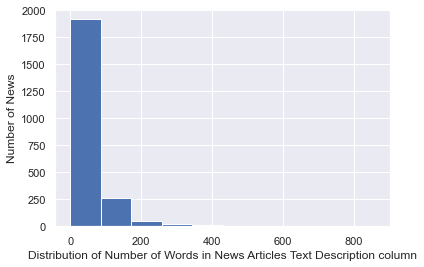

In [190]:
plt.hist(number_of_text_description)
plt.xlabel('Distribution of Number of Words in News Articles Text Description column')
plt.ylabel('Number of News')
plt.show()

##### Selected DF

In [191]:
platform_ds1 = platform_ds1[['title', 'text_description']]

In [192]:
platform_ds1.head(2)

title  \
0  Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's   
1  Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

In [193]:
# Data Pre-Processing

import nltk
import string
import re
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer

ps = nltk.PorterStemmer()
wn = nltk.WordNetLemmatizer()


In [194]:
def make_lower_case(text_description):
    return text_description.lower()

# Define function for removing stop words
def remove_stop_words(text_description):
    text_description = text_description.split()
    stops = set(stopwords.words("english"))
    text_description = [w for w in text_description if not w in stops]
    texts = [w for w in text_description if w.isalpha()]
    texts = " ".join(texts)
    return texts

# Define function for removing punctuation
def remove_punctuation(text_description):
    tokenizer = RegexpTokenizer(r'\w+')
    text_description = tokenizer.tokenize(text_description)
    text_description = " ".join(text_description)
    return text_description

# Define function for removing the html tags
def remove_html(text_description):
    html_pattern = re.compile('<.*?>')
    return html_pattern.sub(r'', text_description)


# Applying the above functions in column 'text_description' and storing as a new column named 'cleaned_desc'
platform_ds1['cleaned_desc'] = platform_ds1['text_description'].apply(func = make_lower_case)
platform_ds1['cleaned_desc'] = platform_ds1.cleaned_desc.apply(func = remove_stop_words)
platform_ds1['cleaned_desc'] = platform_ds1.cleaned_desc.apply(func = remove_punctuation)
platform_ds1['cleaned_desc'] = platform_ds1.cleaned_desc.apply(func = remove_html)

In [195]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import linear_kernel

In [196]:
tf = TfidfVectorizer(analyzer='word',
                     stop_words='english',
                     max_df=0.8,
                     min_df=0.0,
                     use_idf=True,
                     ngram_range=(1,3))
tfidf_matrix = tf.fit_transform(platform_ds1['cleaned_desc'])

In [197]:
platform_ds1.head(2)

title  \
0  Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's   
1  Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

In [198]:
platform_ds1['cleaned_desc'][:2]

0    work still first full public version ethereum software recently system could face technical legal problems tarnished many bitcoin advocates say ethereum face security problems bitcoin greater complexity thus ethereum faced much less many fewer novel design ethereum may also invite intense scrutiny authorities given potentially fraudulent like ponzi written directly ethereum sophisticated capabilities system made fascinating executives corporate ibm said last year experimenting ethereum way control real world objects internet microsoft working several projects make easier use ethereum computing general platform solve problems many industries using fairly elegant solution elegant solution seen said marley director business development strategy gray responsible work database concept bitcoin blockchains designed store transactions data without requiring central authority blockchain ledgers generally maintained updated networks computers working together somewhat similar way wikipedia 

In [199]:
platform_ds1 = platform_ds1.drop_duplicates(subset=None, keep='first', inplace=False)

In [200]:
platform_ds1['cleaned_desc'][:2]

0    work still first full public version ethereum software recently system could face technical legal problems tarnished many bitcoin advocates say ethereum face security problems bitcoin greater complexity thus ethereum faced much less many fewer novel design ethereum may also invite intense scrutiny authorities given potentially fraudulent like ponzi written directly ethereum sophisticated capabilities system made fascinating executives corporate ibm said last year experimenting ethereum way control real world objects internet microsoft working several projects make easier use ethereum computing general platform solve problems many industries using fairly elegant solution elegant solution seen said marley director business development strategy gray responsible work database concept bitcoin blockchains designed store transactions data without requiring central authority blockchain ledgers generally maintained updated networks computers working together somewhat similar way wikipedia 

In [201]:
platform_ds1.shape

(2191, 3)

### Create numpy array from text_description column

In [202]:
keywords_array = platform_ds1['cleaned_desc'].to_numpy()

In [203]:
keywords_array

array(['work still first full public version ethereum software recently system could face technical legal problems tarnished many bitcoin advocates say ethereum face security problems bitcoin greater complexity thus ethereum faced much less many fewer novel design ethereum may also invite intense scrutiny authorities given potentially fraudulent like ponzi written directly ethereum sophisticated capabilities system made fascinating executives corporate ibm said last year experimenting ethereum way control real world objects internet microsoft working several projects make easier use ethereum computing general platform solve problems many industries using fairly elegant solution elegant solution seen said marley director business development strategy gray responsible work database concept bitcoin blockchains designed store transactions data without requiring central authority blockchain ledgers generally maintained updated networks computers working together somewhat similar way wikiped

In [204]:
type(keywords_array[0])

str

### Use splitting to generate words from keywords_array

In [205]:
words_list = []
for keyword in keywords_array:
    splitted_words = keyword.lower().split(' ')
    words_list.append(splitted_words)

In [206]:
words_list

[['work',
  'still',
  'first',
  'full',
  'public',
  'version',
  'ethereum',
  'software',
  'recently',
  'system',
  'could',
  'face',
  'technical',
  'legal',
  'problems',
  'tarnished',
  'many',
  'bitcoin',
  'advocates',
  'say',
  'ethereum',
  'face',
  'security',
  'problems',
  'bitcoin',
  'greater',
  'complexity',
  'thus',
  'ethereum',
  'faced',
  'much',
  'less',
  'many',
  'fewer',
  'novel',
  'design',
  'ethereum',
  'may',
  'also',
  'invite',
  'intense',
  'scrutiny',
  'authorities',
  'given',
  'potentially',
  'fraudulent',
  'like',
  'ponzi',
  'written',
  'directly',
  'ethereum',
  'sophisticated',
  'capabilities',
  'system',
  'made',
  'fascinating',
  'executives',
  'corporate',
  'ibm',
  'said',
  'last',
  'year',
  'experimenting',
  'ethereum',
  'way',
  'control',
  'real',
  'world',
  'objects',
  'internet',
  'microsoft',
  'working',
  'several',
  'projects',
  'make',
  'easier',
  'use',
  'ethereum',
  'computing',
  'g

In [207]:
len(words_list), len(words_list[0]), len(words_list[1]), len(words_list[10])

(2191, 466, 153, 1809)

### Create Dictionary

In [208]:
# Install Gensim

! pip install gensim

In [209]:
from gensim.corpora.dictionary import Dictionary

create a dictionary of words from words list

In [210]:
dictionary = Dictionary(words_list)

In [211]:
dictionary

In [212]:
len(dictionary)

35831

#### Total number of words in the words_list

In [213]:
number_words = 0
for word in words_list:
    number_words = number_words + len(word)

In [214]:
number_words

945434

In [215]:
dictionary.get(0), dictionary.get(1), dictionary.get(20), dictionary.get(1000)

('actual', 'advocates', 'bet', 'reasoning')

## Generate Bag of Words

In [216]:
words_list[0]

['work',
 'still',
 'first',
 'full',
 'public',
 'version',
 'ethereum',
 'software',
 'recently',
 'system',
 'could',
 'face',
 'technical',
 'legal',
 'problems',
 'tarnished',
 'many',
 'bitcoin',
 'advocates',
 'say',
 'ethereum',
 'face',
 'security',
 'problems',
 'bitcoin',
 'greater',
 'complexity',
 'thus',
 'ethereum',
 'faced',
 'much',
 'less',
 'many',
 'fewer',
 'novel',
 'design',
 'ethereum',
 'may',
 'also',
 'invite',
 'intense',
 'scrutiny',
 'authorities',
 'given',
 'potentially',
 'fraudulent',
 'like',
 'ponzi',
 'written',
 'directly',
 'ethereum',
 'sophisticated',
 'capabilities',
 'system',
 'made',
 'fascinating',
 'executives',
 'corporate',
 'ibm',
 'said',
 'last',
 'year',
 'experimenting',
 'ethereum',
 'way',
 'control',
 'real',
 'world',
 'objects',
 'internet',
 'microsoft',
 'working',
 'several',
 'projects',
 'make',
 'easier',
 'use',
 'ethereum',
 'computing',
 'general',
 'platform',
 'solve',
 'problems',
 'many',
 'industries',
 'using',
 

#### doc2bow = Document to BOW[Bag of word]

In [217]:
bow = dictionary.doc2bow(words_list[0])

In [218]:
bow

[(0, 1),
 (1, 1),
 (2, 1),
 (3, 1),
 (4, 1),
 (5, 1),
 (6, 2),
 (7, 3),
 (8, 1),
 (9, 1),
 (10, 4),
 (11, 1),
 (12, 1),
 (13, 1),
 (14, 1),
 (15, 1),
 (16, 3),
 (17, 1),
 (18, 1),
 (19, 1),
 (20, 1),
 (21, 2),
 (22, 1),
 (23, 5),
 (24, 2),
 (25, 1),
 (26, 1),
 (27, 1),
 (28, 1),
 (29, 1),
 (30, 1),
 (31, 1),
 (32, 1),
 (33, 1),
 (34, 1),
 (35, 1),
 (36, 2),
 (37, 1),
 (38, 1),
 (39, 1),
 (40, 1),
 (41, 1),
 (42, 1),
 (43, 1),
 (44, 3),
 (45, 2),
 (46, 1),
 (47, 1),
 (48, 1),
 (49, 1),
 (50, 1),
 (51, 1),
 (52, 2),
 (53, 3),
 (54, 3),
 (55, 1),
 (56, 1),
 (57, 3),
 (58, 1),
 (59, 1),
 (60, 1),
 (61, 1),
 (62, 1),
 (63, 1),
 (64, 1),
 (65, 1),
 (66, 1),
 (67, 1),
 (68, 1),
 (69, 1),
 (70, 1),
 (71, 1),
 (72, 1),
 (73, 1),
 (74, 2),
 (75, 1),
 (76, 1),
 (77, 1),
 (78, 1),
 (79, 2),
 (80, 1),
 (81, 1),
 (82, 1),
 (83, 1),
 (84, 1),
 (85, 7),
 (86, 24),
 (87, 1),
 (88, 2),
 (89, 1),
 (90, 1),
 (91, 1),
 (92, 1),
 (93, 2),
 (94, 1),
 (95, 1),
 (96, 1),
 (97, 1),
 (98, 1),
 (99, 1),
 (100, 1)

In [219]:
len(words_list[0]), len(bow)

(466, 326)

### Generate Corpus by creating BOW of each document

In [220]:
corpus = [dictionary.doc2bow(doc) for doc in words_list]

In [221]:
#print(corpus)

In [222]:
len(corpus), len(corpus[0]), len(corpus[1]), len(corpus[20])

(2191, 326, 129, 82)

In [223]:
len(words_list), len(words_list[0])

(2191, 466)

### TF-IDF Model

#### TF = Term frequency -> count/no.

#### IDF = Inverse doc freq. -> log(N/n)

In [224]:
from gensim.models.tfidfmodel import TfidfModel

In [225]:
# Create tfidf model of the corpus

tfidf = TfidfModel(corpus)

In [226]:
tfidf

In [227]:
print(tfidf[corpus[0]])

[(0, 0.018748844902809685), (1, 0.04007339547795112), (2, 0.02939002866173375), (3, 0.037976671272374585), (4, 0.02539746721591751), (5, 0.018670685262182695), (6, 0.025129895933812877), (7, 0.008946777774866693), (8, 0.00854750076319816), (9, 0.013693002280880894), (10, 0.033308097015183724), (11, 0.021957294096077152), (12, 0.03561407452957598), (13, 0.044911743364085176), (14, 0.0323325393076281), (15, 0.01627771581692958), (16, 0.07214839472584605), (17, 0.0097665376258409), (18, 0.016841535446082884), (19, 0.022016730876269316), (20, 0.029544803995213916), (21, 0.03592946530052181), (22, 0.03632510075344435), (23, 0.12839154084176305), (24, 0.050252736800760374), (25, 0.03895493374736796), (26, 0.028384768236133586), (27, 0.05470321210812808), (28, 0.02428513800736668), (29, 0.04611656949748725), (30, 0.022833591566407022), (31, 0.008996751047731214), (32, 0.010760580572658529), (33, 0.05470321210812808), (34, 0.009955488784269766), (35, 0.04928564380179028), (36, 0.03337834783421

## Generate Similarity Matrix

In [228]:
from gensim.similarities import MatrixSimilarity

In [229]:
sims = MatrixSimilarity(tfidf[corpus], num_features=len(dictionary))

In [230]:
print(sims)

MatrixSimilarity<2191 docs, 35831 features>


In [231]:
sims[corpus[0]]

array([0.90592605, 0.03618848, 0.02996034, ..., 0.0765952 , 0.07818921,
       0.01843292], dtype=float32)

In [232]:
len(sims[corpus[0]])

2191

## Generate Recommendation

In [233]:
news_title = "IEEE to Talk Blockchain at Cloud Computing Oxford-Con - CoinDesk"

In [234]:
# number of recommedations

n=10

In [235]:
platform_ds2 = platform_ds1.loc[platform_ds1.title==news_title] 

In [236]:
platform_ds2

,title,text_description,cleaned_desc
5,IEEE to Talk Blockchain at Cloud Computing Oxford-Con - CoinDesk,"One of the largest and oldest organizations for computing professionals will kick off its annual conference on the future of mobile cloud computing tomorrow, where blockchain is scheduled to be one of the attractions. With more than 421,000 members in 260 countries, the Institute of Electrical and Electronics Engineers (IEEE) holding such a high-profile event has the potential to accelerate the rate of blockchain adoption by the engineering community. At the four-day conference, beginning Tuesday, the IEEE will host five blockchain seminars at the 702-year-old Exeter College of Oxford. The conference, IEEE Mobile Cloud 2016, is the organization's fourth annual event dedicated to mobile cloud computing services and engineering. Speaking at the event, hosted at Oxford University, professor Wei-Tek Tsai of the School of Computing, Informatics and Decision Systems engineering at Arizona State University will talk about the future of blockchain technology as an academic topic of research. Computing shift While this looks to be the first IEEE conference to deal so closely with blockchain, its presence at an event dedicated to cloud computing is no surprise. 2016 is shaping up to be the year many stopped talking about bitcoin as a decentralized ledger and started talking about it as a database. Last month, IBM made a huge splash in the blockchain ecosystem when it announced among a wide range of other news, that it would be offering a wide range of blockchain-related initiatives. Further, in November, Microsoft coined the term Blockchain-as-a-Service (BaaS) to describe its sandbox environment where developers could experiment with tools hosted on the company's Azure Cloud platform. Companies including ConsenSys, Augur, BitShares and Slock.it have joined that effort. Oxford University via Shutterstock",one largest oldest organizations computing professionals kick annual conference future mobile cloud computing blockchain scheduled one members institute electrical electronics engineers holding event potential accelerate rate blockchain adoption engineering beginning ieee host five blockchain seminars exeter college ieee mobile cloud fourth annual event dedicated mobile cloud computing services speaking hosted oxford professor tsai school informatics decision systems engineering arizona state university talk future blockchain technology academic topic computing shift looks first ieee conference deal closely presence event dedicated cloud computing shaping year many stopped talking bitcoin decentralized ledger started talking last ibm made huge splash blockchain ecosystem announced among wide range would offering wide range microsoft coined term describe sandbox environment developers could experiment tools hosted azure cloud companies including bitshares joined oxford university via shutterstock


#### Generate words_list by splitting the keywords column

In [237]:
words_list = platform_ds2['cleaned_desc'].iloc[0].split(' ')

In [238]:
words_list

['one',
 'largest',
 'oldest',
 'organizations',
 'computing',
 'professionals',
 'kick',
 'annual',
 'conference',
 'future',
 'mobile',
 'cloud',
 'computing',
 'blockchain',
 'scheduled',
 'one',
 'members',
 'institute',
 'electrical',
 'electronics',
 'engineers',
 'holding',
 'event',
 'potential',
 'accelerate',
 'rate',
 'blockchain',
 'adoption',
 'engineering',
 'beginning',
 'ieee',
 'host',
 'five',
 'blockchain',
 'seminars',
 'exeter',
 'college',
 'ieee',
 'mobile',
 'cloud',
 'fourth',
 'annual',
 'event',
 'dedicated',
 'mobile',
 'cloud',
 'computing',
 'services',
 'speaking',
 'hosted',
 'oxford',
 'professor',
 'tsai',
 'school',
 'informatics',
 'decision',
 'systems',
 'engineering',
 'arizona',
 'state',
 'university',
 'talk',
 'future',
 'blockchain',
 'technology',
 'academic',
 'topic',
 'computing',
 'shift',
 'looks',
 'first',
 'ieee',
 'conference',
 'deal',
 'closely',
 'presence',
 'event',
 'dedicated',
 'cloud',
 'computing',
 'shaping',
 'year',
 'm

#### set the query_doc to the words_list

In [239]:
query_doc = words_list

In [240]:
query_doc

['one',
 'largest',
 'oldest',
 'organizations',
 'computing',
 'professionals',
 'kick',
 'annual',
 'conference',
 'future',
 'mobile',
 'cloud',
 'computing',
 'blockchain',
 'scheduled',
 'one',
 'members',
 'institute',
 'electrical',
 'electronics',
 'engineers',
 'holding',
 'event',
 'potential',
 'accelerate',
 'rate',
 'blockchain',
 'adoption',
 'engineering',
 'beginning',
 'ieee',
 'host',
 'five',
 'blockchain',
 'seminars',
 'exeter',
 'college',
 'ieee',
 'mobile',
 'cloud',
 'fourth',
 'annual',
 'event',
 'dedicated',
 'mobile',
 'cloud',
 'computing',
 'services',
 'speaking',
 'hosted',
 'oxford',
 'professor',
 'tsai',
 'school',
 'informatics',
 'decision',
 'systems',
 'engineering',
 'arizona',
 'state',
 'university',
 'talk',
 'future',
 'blockchain',
 'technology',
 'academic',
 'topic',
 'computing',
 'shift',
 'looks',
 'first',
 'ieee',
 'conference',
 'deal',
 'closely',
 'presence',
 'event',
 'dedicated',
 'cloud',
 'computing',
 'shaping',
 'year',
 'm

#### Get the Bag Of Words

In [241]:
query_doc_bow = dictionary.doc2bow(query_doc)

In [242]:
query_doc_bow

[(19, 1),
 (23, 1),
 (24, 5),
 (46, 5),
 (53, 1),
 (62, 2),
 (72, 1),
 (90, 1),
 (107, 1),
 (130, 1),
 (132, 1),
 (152, 1),
 (153, 1),
 (166, 1),
 (170, 1),
 (176, 1),
 (199, 2),
 (212, 1),
 (300, 2),
 (322, 1),
 (325, 1),
 (409, 1),
 (451, 5),
 (477, 3),
 (499, 1),
 (507, 1),
 (510, 1),
 (530, 1),
 (536, 2),
 (552, 1),
 (562, 1),
 (606, 1),
 (650, 1),
 (697, 1),
 (699, 1),
 (703, 1),
 (736, 1),
 (737, 1),
 (738, 2),
 (739, 1),
 (740, 1),
 (741, 1),
 (742, 1),
 (743, 1),
 (744, 1),
 (745, 1),
 (746, 1),
 (747, 1),
 (748, 1),
 (749, 1),
 (750, 2),
 (751, 1),
 (752, 1),
 (753, 3),
 (754, 1),
 (755, 1),
 (756, 1),
 (757, 2),
 (758, 1),
 (759, 1),
 (760, 2),
 (761, 3),
 (762, 1),
 (763, 1),
 (764, 1),
 (765, 1),
 (766, 1),
 (767, 1),
 (768, 1),
 (769, 1),
 (770, 1),
 (771, 2),
 (772, 1),
 (773, 1),
 (774, 1),
 (775, 2),
 (776, 1),
 (777, 1),
 (778, 1),
 (779, 1),
 (780, 1),
 (781, 1),
 (782, 1),
 (783, 1),
 (784, 1),
 (785, 1),
 (786, 1),
 (787, 1),
 (788, 1),
 (789, 2),
 (790, 1),
 (791, 

In [243]:
len(query_doc_bow), len(query_doc)

(96, 126)

### Generate TF-IDF values for the query_doc_bow

In [244]:
query_doc_tfidf = tfidf[query_doc_bow] 

In [245]:
query_doc_tfidf

[(19, 0.06029170809425781),
 (23, 0.07031875300385415),
 (24, 0.3440364688059457),
 (46, 0.26745279699846664),
 (53, 0.017728686731989345),
 (62, 0.12091143994502837),
 (72, 0.03209983540273514),
 (90, 0.06585824781353869),
 (107, 0.016448220546303276),
 (130, 0.06808979265318142),
 (132, 0.027757095413489263),
 (152, 0.05628075144784251),
 (153, 0.024979611835155856),
 (166, 0.025552100669515142),
 (170, 0.014709118659980968),
 (176, 0.04680466489059667),
 (199, 0.016822760342620095),
 (212, 0.041512853449365276),
 (300, 0.11338210740035001),
 (322, 0.016638662740359564),
 (325, 0.03608107593466797),
 (409, 0.05548301518509907),
 (451, 0.19327410790469124),
 (477, 0.10699030344372618),
 (499, 0.07432572501926492),
 (507, 0.04144501362908743),
 (510, 0.04537443324211665),
 (530, 0.028190232192210497),
 (536, 0.10818702645225972),
 (552, 0.056011522169943054),
 (562, 0.06181512568272921),
 (606, 0.045293205647931656),
 (650, 0.05385028963855716),
 (697, 0.03383127032659479),
 (699, 0.03

### Get Similarity Score using Similarity Matrix

In [246]:
similarity_array = sims[query_doc_tfidf]

In [247]:
similarity_array

array([0.04810234, 0.01909098, 0.03005002, ..., 0.04185988, 0.05317808,
       0.00303434], dtype=float32)

In [248]:
len(similarity_array)

2191

### Create a Series to Visualize Similarity Score along with News Title

In [249]:
similarity_series = pd.Series(similarity_array.tolist(), index=platform_ds1.title.values)

In [250]:
similarity_series.head

<bound method NDFrame.head of Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's                                                                           0.048102
Bitcoin Future: When GBPcoin of Branson Wins Over USDcoin of Trump                                                                                0.019091
Google Data Center 360° Tour                                                                                                                      0.030050
IBM Wants to "Evolve the Internet" With Blockchain Technology                                                                                     0.157137
IEEE to Talk Blockchain at Cloud Computing Oxford-Con - CoinDesk                                                                                  1.000000
Banks Need To Collaborate With Bitcoin and Fintech Developers                                                                                     0.043742
Blockchain Technology Could Put Bank Aud

### Sort the series to get Top Recommended News

In [251]:
recommended_news = similarity_series.sort_values(ascending=False)[1:n+1] 

In [252]:
recommended_news.head

<bound method NDFrame.head of Red Hat OpenShift Blockchain Initiative Focuses On Ethereum       0.211857
Microsoft Strikes Partnership With Banks on Blockchain Tech       0.207187
Decentralizing IoT networks through blockchain                    0.195735
Blockchain Huge Potential For The Insurance Industry              0.190643
Venture Capitalists Inject Nearly Half a Billion in Bitcoin       0.181147
Walt Disney Now Loves Blockchain, Going Trustless in Seattle      0.176281
Blockchain Will Be Used By 15% of Big Banks By 2017               0.175619
4 Blockchain Macro Trends: Where to Place Your Bets               0.169001
Blockchain won't kill banks: Bitcoin pioneer                      0.167728
IBM Watson is Working to Bring AI to the Blockchain - CoinDesk    0.163626
dtype: float64>

### Corpus for 15th index

In [253]:
corpus[15]

[(23, 1),
 (24, 1),
 (50, 2),
 (71, 2),
 (158, 4),
 (160, 1),
 (187, 1),
 (189, 1),
 (199, 1),
 (222, 1),
 (248, 1),
 (257, 2),
 (276, 2),
 (305, 2),
 (307, 2),
 (326, 1),
 (349, 1),
 (371, 1),
 (447, 1),
 (551, 1),
 (560, 1),
 (610, 1),
 (612, 1),
 (626, 1),
 (643, 1),
 (659, 1),
 (693, 1),
 (766, 1),
 (783, 1),
 (794, 1),
 (808, 1),
 (826, 1),
 (840, 1),
 (864, 1),
 (890, 5),
 (1186, 1),
 (1273, 1),
 (1293, 1),
 (1295, 1),
 (1339, 1),
 (1502, 1),
 (1672, 1),
 (1736, 1),
 (2152, 2),
 (2215, 1),
 (2358, 1),
 (2421, 1),
 (2432, 1),
 (2481, 1),
 (2482, 1),
 (2483, 1),
 (2484, 1),
 (2485, 1),
 (2486, 3),
 (2487, 1),
 (2488, 2),
 (2489, 1),
 (2490, 1),
 (2491, 1),
 (2492, 1),
 (2493, 1),
 (2494, 1),
 (2495, 1),
 (2496, 1),
 (2497, 1),
 (2498, 1),
 (2499, 1),
 (2500, 1),
 (2501, 1),
 (2502, 1),
 (2503, 1),
 (2504, 1),
 (2505, 1),
 (2506, 1),
 (2507, 1),
 (2508, 1)]

In [254]:
corpus[platform_ds2.index.values.tolist()[0]]

[(5, 3),
 (7, 1),
 (10, 3),
 (11, 1),
 (14, 3),
 (16, 9),
 (23, 10),
 (24, 1),
 (40, 1),
 (51, 1),
 (57, 2),
 (68, 1),
 (71, 1),
 (72, 2),
 (84, 1),
 (97, 2),
 (105, 7),
 (116, 1),
 (137, 1),
 (157, 1),
 (162, 2),
 (163, 1),
 (168, 3),
 (173, 1),
 (177, 1),
 (179, 1),
 (185, 1),
 (189, 1),
 (209, 3),
 (212, 1),
 (214, 1),
 (229, 1),
 (247, 2),
 (250, 1),
 (260, 2),
 (279, 1),
 (283, 1),
 (288, 2),
 (297, 1),
 (304, 1),
 (319, 2),
 (321, 2),
 (322, 3),
 (355, 1),
 (384, 2),
 (388, 1),
 (431, 2),
 (472, 1),
 (506, 3),
 (530, 3),
 (535, 1),
 (541, 1),
 (557, 3),
 (562, 1),
 (574, 1),
 (590, 2),
 (596, 1),
 (635, 1),
 (646, 2),
 (678, 1),
 (692, 1),
 (700, 1),
 (703, 4),
 (705, 1),
 (706, 1),
 (708, 3),
 (734, 2),
 (780, 2),
 (796, 1),
 (797, 2),
 (798, 3),
 (799, 1),
 (800, 1),
 (801, 2),
 (802, 1),
 (803, 2),
 (804, 1),
 (805, 1),
 (806, 1),
 (807, 5),
 (808, 6),
 (809, 1),
 (810, 1),
 (811, 2),
 (812, 1),
 (813, 2),
 (814, 1),
 (815, 1),
 (816, 2),
 (817, 1),
 (818, 1),
 (819, 1),
 (820

#### TF-IDF Values

In [255]:
tfidf[corpus[platform_ds2.index.values.tolist()[0]]]

[(5, 0.0753841071159356),
 (7, 0.004013688628588645),
 (10, 0.03362090247306552),
 (11, 0.029551334741623646),
 (14, 0.13054473214399281),
 (16, 0.2913038402116021),
 (23, 0.34559280253805386),
 (24, 0.03381644933988685),
 (40, 0.028490963367611526),
 (51, 0.02088038014325768),
 (57, 0.07466388692593502),
 (68, 0.018373577692987527),
 (71, 0.023306568345908985),
 (72, 0.03155195905488667),
 (84, 0.032263456391430884),
 (97, 0.035936857523259196),
 (105, 0.16629318686923134),
 (116, 0.02806731952821022),
 (137, 0.03393666855584818),
 (157, 0.02446879413840263),
 (162, 0.031423285052528865),
 (163, 0.013330227736819132),
 (168, 0.05512073307896258),
 (173, 0.010198062266663754),
 (177, 0.01249481238861717),
 (179, 0.023306568345908985),
 (185, 0.0256648392576264),
 (189, 0.003950595069150293),
 (209, 0.0993678991920673),
 (212, 0.020402158388860125),
 (214, 0.0195987859155867),
 (229, 0.015395730889077457),
 (247, 0.03846785242121821),
 (250, 0.01725152397075706),
 (260, 0.04404735940563

#### Sorted TF-IDF values

In [256]:
sorted_tfidf_weights = sorted(tfidf[corpus[platform_ds1.index.values.tolist()[0]]], key=lambda w: w[1], reverse=True)

In [257]:
sorted_tfidf_weights

[(86, 0.7706966059322066),
 (85, 0.28051376834565783),
 (23, 0.12839154084176305),
 (112, 0.09857128760358055),
 (57, 0.08321537442841052),
 (125, 0.08300987185070036),
 (147, 0.07421468590002715),
 (79, 0.0734128794906664),
 (16, 0.07214839472584605),
 (187, 0.07212802926339498),
 (167, 0.06872170516508673),
 (239, 0.06194453382686715),
 (279, 0.061845342572794025),
 (308, 0.06116895059405429),
 (194, 0.06012078041446588),
 (203, 0.06012078041446588),
 (281, 0.06012078041446588),
 (141, 0.05912640028212716),
 (27, 0.05470321210812808),
 (33, 0.05470321210812808),
 (56, 0.05470321210812808),
 (193, 0.05470321210812808),
 (215, 0.05470321210812808),
 (88, 0.052138369121944965),
 (210, 0.05153413780382505),
 (258, 0.05153413780382505),
 (313, 0.05153413780382505),
 (24, 0.050252736800760374),
 (35, 0.04928564380179028),
 (70, 0.04928564380179028),
 (238, 0.04928564380179028),
 (273, 0.04928564380179028),
 (164, 0.0475415763580088),
 (172, 0.0475415763580088),
 (44, 0.047255539349431656),

In [258]:
dictionary.get(3000)

'suggest'

In [259]:
dictionary.get(5000)

'amok'

In [260]:
print('Top words associated with this news by tf-idf values are: ')
for term_id, weight in sorted_tfidf_weights[:10]:
    print(" '%s' %.5f" %(dictionary.get(term_id), weight))

Top words associated with this news by tf-idf values are: 
 'ethereum' 0.77070
 'ether' 0.28051
 'bitcoin' 0.12839
 'fortress' 0.09857
 'currency' 0.08322
 'helped' 0.08301
 'joseph' 0.07421
 'elegant' 0.07341
 'banks' 0.07215
 'network' 0.07213


In [261]:
platform_ds2.columns

Index(['title', 'text_description', 'cleaned_desc'], dtype='object')

# Creating a Modular code by creating a function for Query News Input

In [262]:
def news_recommendation(news_title, number_of_hits):
    platform_ds2 = platform_ds1.loc[platform_ds1.title==news_title] # get the news title row
    
    keywords = platform_ds2['cleaned_desc'].iloc[0].split(' ') # get the keywords as a Series (platform_ds2['cleaned_desc'])
    
    query_doc = keywords #set the query_doc to the list of keywords
    
    query_doc_bow = dictionary.doc2bow(query_doc) # get a bag of words from the query_doc
    
    query_doc_tfidf = tfidf[query_doc_bow] # convert the regular bag of words model to a tf-idf model

    similarity_array = sims[query_doc_tfidf] # get the array of similarity values between our news and every other news. 

    similarity_series = pd.Series(similarity_array.tolist(), index=platform_ds1.title.values) # convert to a Series
    
    recommended_news = similarity_series.sort_values(ascending=False)[1:number_of_hits+1] 
    
    # get the top matching results, i.e. most similar news title
    # start from index 1 because every item is most similar to itself
    
    return recommended_news

In [263]:
type(recommended_news)

pandas.core.series.Series

In [264]:
news_recommendation("French Senate Will Debate on Bitcoin Regulation", 10)

Blockchain CEO's Business Advice on Bitcoin Startups                                           0.363541
Are you a bitcoin denialist? - Chris Skinner's blog                                            0.346453
Australian Bitcoin Entrepreneur Launches Robo-Advice Platform                                  0.303573
Growing Global Electricity Consumption Is Not Just Bitcoin's Fault                             0.285929
Governments vs Bitcoin: A Fight For Control                                                    0.268901
Ethereum and Bitcoin Are Market Leaders But Not Competitors                                    0.264645
Venture Capitalists Inject Nearly Half a Billion in Bitcoin                                    0.250976
Bitcoin For A Tesla Model 3...Yes That Happened                                                0.240076
Three Platforms Bringing Bitcoin To Social Messaging Users                                     0.219764
How Inflation Is Stealing Your Money: Can Cryptocurrency Solve I

In [265]:
news_recommendation('Fooling The Machine', 10)

How Google is Remaking Itself as a "Machine Learning First" Company - Backchannel    0.145282
How Google is Remaking Itself as a "Machine Learning First" Company - Backchannel    0.143733
Machine Learning for Designers                                                       0.131896
Machine Learning is Fun! Part 3: Deep Learning and Convolutional Neural Networks     0.130061
Why Deep Learning Is Suddenly Changing Your Life                                     0.128083
An Exclusive Look at How AI and Machine Learning Work at Apple - Backchannel         0.127657
An introduction to Generative Adversarial Networks (with code in TensorFlow)         0.124244
Machine Learning Can Identify Pixelated Faces, Researchers Show                      0.121595
​Google digs deeper on machine learning with new European research lab               0.119507
AI can learn from data without ever having access to it                              0.118174
dtype: float64

# 6. ALS Model - Alternating Least Square

## Building Recommendation system using ALS on Consumer Dataset

In [266]:
consumer_ds.head(2)

,event_timestamp,interaction_type,item_id,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country,Ratings,device_name
0,1465413032,content_watched,-3499919498720038879,-8845298781299428018,1264196770339959068,NaN,NaN,NaN,1,NaN
1,1465412560,content_watched,8890720798209849691,-1032019229384696495,3621737643587579081,"Mozilla/5.0 (Macintosh; Intel Mac OS X 10_11_2) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/52.0.2743.24 Safari/537.36",NY,US,1,Mozilla/5.0


In [267]:
consumer_ds.shape

(72312, 10)

In [268]:
consumer_ds['consumer_id'].nunique()

1895

In [269]:
consumer_ds['item_id'].nunique()

2987

## Creating Sparse User-Item Matrix

In [270]:
from scipy.sparse import csr_matrix

In [271]:
alpha = 40

In [272]:
consumer_ds.shape

(72312, 10)

In [273]:
consumer_ds.dropna(inplace=True)

In [274]:
consumer_ds = consumer_ds.drop_duplicates(subset=None, keep='first', inplace=False)

In [275]:
consumer_ds.shape

(56896, 10)

In [276]:
#consumer_ds['consumer_id_abs'] = consumer_ds['consumer_id'].apply(lambda x: abs(x))

In [277]:
#consumer_ds['item_id_abs'] = consumer_ds['item_id'].apply(lambda x: abs(x))

In [278]:
consumer_ds.head(2)

,event_timestamp,interaction_type,item_id,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country,Ratings,device_name
1,1465412560,content_watched,8890720798209849691,-1032019229384696495,3621737643587579081,"Mozilla/5.0 (Macintosh; Intel Mac OS X 10_11_2) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/52.0.2743.24 Safari/537.36",NY,US,1,Mozilla/5.0
5,1465413742,content_watched,310515487419366995,-8763398617720485024,1395789369402380392,"Mozilla/5.0 (Windows NT 10.0; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/50.0.2661.102 Safari/537.36",MG,BR,1,Mozilla/5.0


In [279]:
type(consumer_ds)

pandas.core.frame.DataFrame

In [280]:
#sparse_user_item = csr_matrix( ([alpha]*consumer_ds.shape[0], (consumer_ds['consumer_id_abs'], consumer_ds['item_id_abs']) ))

In [281]:
users_items_pivot_matrix_df = consumer_ds.pivot_table(index='consumer_id', 
                                                columns='item_id', 
                                                values='Ratings').fillna(0)

users_items_pivot_matrix_df.head(10)

item_id               -9222795471790223670  -9216926795620865886  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   1.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   
-9188188261933657343                   0.0                   0.0   
-9172914609055320039                   0.0                   0.0   
-9156344805277471150                   0.0                   0.0   
-9150583489352258206                   0.0                   0.0   
-9120685872592674274                   0.0                   0.0   

item_id               -9194572880052200111  -9192549002213406534  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   
-9188188261933657343                   0.0                   0.0   
-9172914609055320039                   0.0                   0.0   
-9156344805277471150                   0.0                   0.0   
-9150583489352258206                   0.0                   0.0   
-9120685872592674274                   0.0                   0.0   

item_id               -9190737901804729417  -9189659052158407108  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   
-9188188261933657343                   0.0                   0.0   
-9172914609055320039                   0.0                   0.0   
-9156344805277471150                   0.0                   0.0   
-9150583489352258206                   0.0                   0.0   
-9120685872592674274                   0.0                   0.0   

item_id               -9184137057748005562  -9176143510534135851  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   
-9188188261933657343                   0.0                   0.0   
-9172914609055320039                   0.0                   0.0   
-9156344805277471150                   0.0                   0.0   
-9150583489352258206                   0.0                   0.0   
-9120685872592674274                   0.0                   0.0   

item_id               -9172673334835262304  -9171475473795142532  \
consumer_id                                                        
-9223121837663643404                   0.0                   0.0   
-9212075797126931087                   0.0                   0.0   
-9207251133131336884                   0.0                   0.0   
-9199575329909162940                   0.0                   0.0   
-9196668942822132778                   0.0                   0.0   
-9188188261933657343                   0.0                   0.0   
-9172914609055320039                   0.0                   0.0   
-9156344805277471150                   0.0                   0.0   
-9150583489352258206                   0.0          

In [282]:
users_ids = list(users_items_pivot_matrix_df.index)
users_ids[:10]

[-9223121837663643404,
 -9212075797126931087,
 -9207251133131336884,
 -9199575329909162940,
 -9196668942822132778,
 -9188188261933657343,
 -9172914609055320039,
 -9156344805277471150,
 -9150583489352258206,
 -9120685872592674274]

In [283]:
users_items_pivot_sparse_matrix = csr_matrix(users_items_pivot_matrix_df)
users_items_pivot_sparse_matrix

<1895x2982 sparse matrix of type '<class 'numpy.float64'>'
	with 40307 stored elements in Compressed Sparse Row format>

Shape 1895x2982 sparse matrix

In [284]:
csr_user_array = users_items_pivot_sparse_matrix.toarray()

In [285]:
csr_user_array

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [286]:
len(csr_user_array), len(csr_user_array[0]), csr_user_array[1][1]

(1895, 2982, 0.0)

In [287]:
max(csr_user_array[1])

1.0

### csr matrix only stores where value is 40 [non-zero]. (Compressed Sparse Row)

In [288]:
print(users_items_pivot_sparse_matrix)

  (0, 65)	1.0
  (0, 159)	1.0
  (0, 187)	1.0
  (0, 195)	1.0
  (0, 313)	1.0
  (0, 327)	1.0
  (0, 385)	1.0
  (0, 416)	1.0
  (0, 442)	1.0
  (0, 450)	1.0
  (0, 452)	1.0
  (0, 464)	1.0
  (0, 569)	1.0
  (0, 700)	1.0
  (0, 767)	1.0
  (0, 811)	1.0
  (0, 817)	1.0
  (0, 862)	1.0
  (0, 888)	1.0
  (0, 1085)	1.0
  (0, 1355)	1.0
  (0, 1387)	1.0
  (0, 1408)	1.0
  (0, 1615)	1.0
  (0, 1629)	1.0
  :	:
  (1894, 1974)	2.75
  (1894, 2020)	1.0
  (1894, 2024)	1.0
  (1894, 2068)	1.3125
  (1894, 2077)	1.0
  (1894, 2186)	1.0
  (1894, 2249)	1.0
  (1894, 2329)	1.0
  (1894, 2344)	1.0
  (1894, 2446)	1.0
  (1894, 2465)	1.0
  (1894, 2533)	1.0
  (1894, 2603)	1.0
  (1894, 2671)	2.0
  (1894, 2691)	1.0
  (1894, 2714)	1.0
  (1894, 2767)	1.0
  (1894, 2804)	1.0
  (1894, 2809)	1.5
  (1894, 2840)	1.0
  (1894, 2856)	2.75
  (1894, 2862)	1.0
  (1894, 2917)	1.0
  (1894, 2920)	1.0
  (1894, 2976)	1.0


In [289]:
users_items_pivot_sparse_matrix = users_items_pivot_sparse_matrix.T.tocsr()

In [290]:
users_items_pivot_sparse_matrix

<2982x1895 sparse matrix of type '<class 'numpy.float64'>'
	with 40307 stored elements in Compressed Sparse Row format>

In [291]:
csr_item_array = users_items_pivot_sparse_matrix.toarray()

In [292]:
csr_item_array

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [293]:
len(csr_item_array), len(csr_item_array[0]), csr_item_array[1][1]

(2982, 1895, 0.0)

In [294]:
print(users_items_pivot_sparse_matrix)

  (0, 333)	1.0
  (0, 831)	1.0
  (0, 1142)	1.0
  (0, 1867)	1.0
  (1, 2)	1.0
  (1, 130)	1.0
  (1, 210)	1.0
  (1, 555)	1.0
  (1, 941)	1.0
  (1, 946)	1.0
  (1, 1149)	1.0
  (1, 1235)	1.0
  (1, 1499)	1.0
  (1, 1532)	1.0
  (2, 40)	1.0
  (2, 159)	1.0
  (2, 197)	1.0
  (2, 334)	1.0
  (2, 630)	1.0
  (2, 651)	1.0
  (2, 820)	3.0
  (2, 906)	1.0
  (2, 935)	1.3333333333333333
  (2, 1004)	1.0
  (2, 1182)	1.0
  :	:
  (2980, 798)	1.0
  (2980, 908)	1.0
  (2980, 978)	1.0
  (2980, 1079)	1.0
  (2980, 1136)	1.0
  (2980, 1221)	1.0
  (2980, 1248)	1.0
  (2980, 1263)	1.0
  (2980, 1319)	1.0
  (2980, 1334)	1.0
  (2980, 1343)	1.0
  (2980, 1383)	1.0
  (2980, 1404)	1.0
  (2980, 1405)	1.0
  (2980, 1527)	1.0
  (2980, 1597)	1.0
  (2980, 1728)	1.0
  (2980, 1833)	1.0
  (2980, 1874)	1.0
  (2980, 1888)	1.0
  (2981, 170)	1.0
  (2981, 588)	1.0
  (2981, 1004)	1.0
  (2981, 1237)	1.0
  (2981, 1597)	1.0


In [304]:
#! pip install implicit

In [305]:
import implicit
from implicit.evaluation import train_test_split

In [245]:
train, test = train_test_split(users_items_pivot_sparse_matrix, train_percentage=0.8)

In [246]:
train

<2982x1895 sparse matrix of type '<class 'numpy.float64'>'
	with 32206 stored elements in Compressed Sparse Row format>

In [247]:
test

<2982x1895 sparse matrix of type '<class 'numpy.float64'>'
	with 8101 stored elements in Compressed Sparse Row format>

In [248]:
model = implicit.als.AlternatingLeastSquares(factors=100, regularization=0.1, iterations=20, calculate_training_loss=False)

In [249]:
model

In [250]:
# Train the Model

model.fit(train)

In [251]:
user_id = 100

In [252]:
consumer_ds['consumer_id'].loc[100]

-2772844562500836582

In [253]:
model.recommend(user_id, users_items_pivot_sparse_matrix)

[(405, 0.7917182),
 (220, 0.083242804),
 (2264, 0.08091235),
 (773, 0.076838285),
 (1641, 0.073131636),
 (453, 0.066273585),
 (985, 0.053146917),
 (1265, 0.047684148),
 (2846, 0.047538295),
 (2455, 0.04638391)]

In [254]:
model.recommend(user_id, users_items_pivot_sparse_matrix, N=30)

[(405, 0.7917182),
 (220, 0.083242804),
 (2264, 0.08091235),
 (773, 0.076838285),
 (1641, 0.073131636),
 (453, 0.066273585),
 (985, 0.053146917),
 (1265, 0.047684148),
 (2846, 0.047538295),
 (2455, 0.04638391),
 (353, 0.04606319),
 (242, 0.046025738),
 (690, 0.042163458),
 (1268, 0.04106464),
 (1450, 0.04096661),
 (2043, 0.04078889),
 (431, 0.040539674),
 (750, 0.040332843),
 (2295, 0.038023815),
 (2432, 0.037959978),
 (2624, 0.03753463),
 (354, 0.03426987),
 (635, 0.033681627),
 (2451, 0.03341092),
 (1815, 0.03322913),
 (1540, 0.032849386),
 (1805, 0.03253741),
 (465, 0.03242452),
 (1865, 0.032330416),
 (2167, 0.032249708)]

### Generating recommendations for News_id / item_id

In [265]:
item_id = 20
n_similar = 2982

In [266]:
similar = model.similar_items(item_id, n_similar)

In [267]:
similar

[(20, 0.9999999),
 (1337, 0.960915),
 (2719, 0.8085353),
 (2741, 0.7956202),
 (2424, 0.7435722),
 (2754, 0.7435722),
 (2851, 0.7435722),
 (613, 0.7435721),
 (638, 0.74357206),
 (894, 0.74357206),
 (2826, 0.74357206),
 (435, 0.743572),
 (1723, 0.71870995),
 (2623, 0.67530507),
 (648, 0.67500323),
 (245, 0.67311907),
 (207, 0.6685638),
 (463, 0.6685638),
 (1834, 0.6685638),
 (156, 0.66856366),
 (889, 0.66856366),
 (1168, 0.66856366),
 (2099, 0.66856366),
 (879, 0.6654039),
 (330, 0.64209306),
 (758, 0.6412206),
 (1128, 0.63833815),
 (1497, 0.6030079),
 (2898, 0.5893666),
 (2299, 0.5892339),
 (1948, 0.5870921),
 (748, 0.58259887),
 (1194, 0.57732683),
 (2947, 0.5712295),
 (2902, 0.54684496),
 (2239, 0.5400055),
 (478, 0.5393649),
 (1714, 0.53295135),
 (1902, 0.5284085),
 (562, 0.5167892),
 (1581, 0.50786304),
 (1738, 0.50596863),
 (1939, 0.5059686),
 (2802, 0.5059686),
 (507, 0.501544),
 (669, 0.50094175),
 (1428, 0.49476188),
 (4, 0.48529035),
 (2731, 0.4848027),
 (467, 0.4847552),
 (256

In [268]:
output = pd.DataFrame(similar, columns=['news_id', 'als_score'])

In [269]:
output

,news_id,als_score
0,20,1.000000
1,1337,0.960915
2,2719,0.808535
3,2741,0.795620
4,2424,0.743572
5,2754,0.743572
6,2851,0.743572
7,613,0.743572
8,638,0.743572
9,894,0.743572


## Merging recommendations

In [305]:
consumer_ds1 = consumer_ds[['consumer_id', 'item_id', 'interaction_type']]

In [318]:
# Consusmer Interaction Type
interaction = consumer_ds1['interaction_type'].value_counts()*100/consumer_ds1.shape[0]

In [319]:
interaction

content_watched         95.648200
content_liked            2.207537
content_saved            0.841887
content_followed         0.708310
content_commented_on     0.594066
Name: interaction_type, dtype: float64

In [320]:
interaction_ds = pd.DataFrame(interaction)

In [321]:
type(interaction_ds)

pandas.core.frame.DataFrame

In [322]:
interaction_ds

,interaction_type
content_watched,95.648200
content_liked,2.207537
content_saved,0.841887
content_followed,0.708310
content_commented_on,0.594066


In [323]:
interaction_ds.reset_index(inplace=True)

In [324]:
interaction_ds

,index,interaction_type
0,content_watched,95.648200
1,content_liked,2.207537
2,content_saved,0.841887
3,content_followed,0.708310
4,content_commented_on,0.594066


In [325]:
interaction_ds.columns = ['interaction_type', 'value']

### Creating a rating column

In [326]:
interaction_ds['rating1'] = 100/interaction_ds['value']

In [327]:
interaction_ds.head(3)

,interaction_type,value,rating1
0,content_watched,95.648200,1.045498
1,content_liked,2.207537,45.299363
2,content_saved,0.841887,118.780793


In [330]:
consumer_ratings = pd.merge(consumer_ds1, interaction_ds, on='interaction_type', how='left')

In [331]:
consumer_ratings.head(3)

,consumer_id,item_id,interaction_type,value,rating1
0,-1032019229384696495,8890720798209849691,content_watched,95.6482,1.045498
1,-8763398617720485024,310515487419366995,content_watched,95.6482,1.045498
2,4254153380739593270,-1492913151930215984,content_watched,95.6482,1.045498


In [332]:
consumer_ratings = consumer_ratings[['consumer_id', 'item_id', 'rating1']]

In [333]:
consumer_ratings.head(3)

,consumer_id,item_id,rating1
0,-1032019229384696495,8890720798209849691,1.045498
1,-8763398617720485024,310515487419366995,1.045498
2,4254153380739593270,-1492913151930215984,1.045498


In [334]:
consumer_ratings.shape

(56896, 3)

In [335]:
consumer_ratings['news_id'] = consumer_ratings.groupby(['item_id']).ngroup()

In [337]:
consumer_ratings['user_id'] = consumer_ratings.groupby(['consumer_id']).ngroup()

In [338]:
consumer_ratings.head(3)

,consumer_id,item_id,rating1,news_id,user_id
0,-1032019229384696495,8890720798209849691,1.045498,2928,831
1,-8763398617720485024,310515487419366995,1.045498,1534,42
2,4254153380739593270,-1492913151930215984,1.045498,1228,1390


In [339]:
consumer_ratings.describe()

,consumer_id,item_id,rating1,news_id,user_id
count,5.689600e+04,5.689600e+04,56896.000000,56896.000000,56896.000000
mean,1.644579e+16,-7.568504e+16,5.000000,1474.924441,945.907832
std,5.054700e+18,5.362304e+18,21.204859,857.559234,518.207251
min,-9.223122e+18,-9.222795e+18,1.045498,0.000000,0.000000
25%,-3.596627e+18,-4.798432e+18,1.045498,725.000000,588.000000
50%,-4.816180e+16,-7.527881e+15,1.045498,1478.000000,933.000000
75%,3.813843e+18,4.508362e+18,1.045498,2195.000000,1343.000000
max,9.210531e+18,9.222265e+18,168.331361,2981.000000,1894.000000


In [340]:
ratings_ds = consumer_ratings[['user_id', 'news_id', 'rating1']]

In [341]:
ratings_ds.head(3)

,user_id,news_id,rating1
0,831,2928,1.045498
1,42,1534,1.045498
2,1390,1228,1.045498


In [342]:
news_mapping = consumer_ratings[['item_id', 'news_id']]

In [343]:
news_mapping.head(3)

,item_id,news_id
0,8890720798209849691,2928
1,310515487419366995,1534
2,-1492913151930215984,1228


In [345]:
news_mapping.shape

(56896, 2)

In [346]:
news_mapping1 = news_mapping.drop_duplicates()

In [347]:
news_mapping1.shape

(2982, 2)

In [348]:
als_ds1 = pd.merge(output, news_mapping1, on='news_id', how='left')

In [350]:
als_ds1.head()

,news_id,als_score,item_id
0,20,1.000000,-9107331682787867601
1,1337,0.960915,-844797936291539016
2,2719,0.808535,7555106864392724379
3,2741,0.795620,7748594134538052724
4,2424,0.743572,5843350704442714396


In [360]:
news_title.shape

(2264, 2)

In [368]:
als_title = pd.merge(als_ds1, news_title, on='item_id', how='left')

In [369]:
als_title.head(3)

,news_id,als_score,item_id,title
0,20,1.000000,-9107331682787867601,Hopper raises $16 million for a travel app that tells you the best time to fly
1,1337,0.960915,-844797936291539016,How people using Slack to organise their grocery lists is helping it grow
2,2719,0.808535,7555106864392724379,Chat app Kik launches a bot store and anyone can make bots for it


In [370]:
als_title.shape

(3026, 4)

In [377]:
# Calculating ALS Score using Normalization

als_title['als_score_normalized'] = (als_title['als_score']-min(als_title['als_score'])) / (max(als_title['als_score']) - min(als_title['als_score']))

In [378]:
als_title

,news_id,als_score,item_id,title,als_score_normalized
0,20,1.000000,-9107331682787867601,Hopper raises $16 million for a travel app that tells you the best time to fly,1.000000e+00
1,1337,0.960915,-844797936291539016,How people using Slack to organise their grocery lists is helping it grow,9.665082e-01
2,2719,0.808535,7555106864392724379,Chat app Kik launches a bot store and anyone can make bots for it,8.359339e-01
3,2741,0.795620,7748594134538052724,Fooling The Machine,8.248670e-01
4,2424,0.743572,5843350704442714396,The 7 Habits of a Highly Effective Product Owner,7.802670e-01
5,2754,0.743572,7828019124127586556,How to grow your startup with no budget,7.802670e-01
6,2851,0.743572,8433131156569129937,"Predicting the future, one week at a time",7.802670e-01
7,613,0.743572,-5570256785328462468,The Black Death: The Greatest Catastrophe Ever,7.802669e-01
8,638,0.743572,-5405021817466310759,Why 5 is the magic number for UX usability testing,7.802669e-01
9,894,0.743572,-3718969219417182449,Platforms are the real powerhouses in Silicon Valley's business landscape,7.802669e-01


# Hybrid Recommendation System

## Hybrid-1: Content Based + Item Based Collaboriative Model

In [572]:
news_index = 30

In [573]:
news_prediction = pd.DataFrame(item_correlation)

In [574]:
news_prediction.head(3)

0    1    2         3    4         5    6         7    8    9   10   11  \
0  1.0  0.0  0.0  0.079062  0.0  0.000000  0.0  0.161987  0.0  0.0  0.0  0.0   
1  0.0  1.0  0.0  0.000000  0.0  0.007316  0.0  0.000000  0.0  0.0  0.0  0.0   
2  0.0  0.0  1.0  0.000000  0.0  0.004675  0.0  0.000000  0.0  0.0  0.0  0.0   

    12   13   14   15   16        17   18   19   20   21   22   23   24   25  \
0  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
1  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2  0.0  0.0  0.0  0.0  0.0  0.000364  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

    26   27        28        29   30   31   32        33   34        35   36  \
0  0.0  0.0  0.133655  0.036451  0.0  0.0  0.0  0.000000  0.0  0.387672  0.0   
1  0.0  0.0  0.000000  0.000000  0.0  0.0  0.0  0.000000  0.0  0.000000  0.0   
2  0.0  0.0  0.000000  0.000000  0.0  0.0  0.0  0.012803  0.0  0.000000  0.0   

    37   38   39   40   41   42   43   44   45        46   47        48  \
0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.000000   
1  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.000000   
2  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.011369  0.0  0.830172   

         49        50   51        52   53   54        55   56   57   58  \
0  0.172427  0.000000  0.0  0.053813  0.0  0.0  0.000000  0.0  0.0  0.0   
1  0.000000  0.000000  0.0  0.000000  0.0  0.0  0.000000  0.0  0.0  0.0   
2  0.000000  0.013042  0.0  0.000000  0.0  0.0  0.004741  0.0  0.0  0.0   

         59        60   61        62   63        64   65   66   67   68   69  \
0  0.074417  0.000000  0.0  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0   
1  0.000000  0.000000  0.0  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0   
2  0.000000  0.278469  0.0  0.003142  0.0  0.251428  0.0  0.0  0.0  0.0  0.0   

    70   71       72        73   74   75   76   77   78   79   80   81  \
0  0.0  0.0  0.00000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
1  0.0  0.0  0.00000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2  0.0  0.0  0.02964  0.048047  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

        82   83   84   85   86        87   88   89   90   91        92   93  \
0  0.28701  0.0  0.0  0.0  0.0  0.324591  0.0  0.0  0.0  0.0  0.348747  0.0   
1  0.00000  0.0  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.0  0.000000  0.0   
2  0.00000  0.0  0.0  0.0  0.0  0.000000  0.0  0.0  0.0  0.0  0.000000  0.0   

         94   95        96   97   98   99  100  101  102  103       104  105  \
0  0.252404  0.0  0.106649  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.333899  0.0   
1  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.000000  0.0   
2  0.000000  0.0  0.000000  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.000000  0.0   

   106  107  108  109  110      111     112       113  114       115  116  \
0  0.0  0.0  0.0  0.0  0.0  0.51628  0.0294  0.000000  0.0  0.059315  0.0   
1  0.0  0.0  0.0  0.0  0.0  0.00000  0.0000  0.000000  0.0  0.000000  0.0   
2  0.0  0.0  0.0  0.0  0.0  0.00000  0.0000  0.014845  0.0  0.000000  0.0   

   117  118  119  120       121  122       123  124  125       126  127  128  \
0  0.0  0.0  0.0  0.0  0.031945  0.0  0.291451  0.0  0.0  0.000000  0.0  0.0   
1  0.0  0.0  0.0  0.0  0.000000  0.0  0.000000  0.0  0.0  0.000000  0.0  0.0   
2  0.0  0.0  0.0  0.0  0.018862  0.0  0.000000  0.0  0.0  0.012803  0.0  0.0   

   129       130  131  132  133  134      135  136       137  138  139  140  \
0  0.0  0.211327  0.0  0.0  0.0  0.0  0.00000  0.0  0.000000  0.0  0.0  0.0   
1  0.0  0.000000  0.0  0.0  0.0  0.0  0.00000  0.0  0.000000  0.0  0.0  0.0   
2  0.0  0.000000  0.0  0.0  0.0  0.0  0.02383  0.0  0.827665  0.0  0.0  0.0   

   141  142  143  144  145  146  147  148  149  150       151  152  153  154  \
0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.134387  0.0  0.0  0.0   
1  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.000000  0.0  0.0  0.0 

In [575]:
item_recommendation = pd.DataFrame(news_prediction.iloc[news_index].sort_values(ascending=False))

In [576]:
item_recommendation

,30
30,1.000000
1287,0.933716
1595,0.929487
1992,0.911465
542,0.898717
2345,0.861457
1275,0.859338
1154,0.855163
196,0.836627
671,0.832050


In [577]:
item_recommendation.reset_index(inplace=True)

In [578]:
item_recommendation.columns = ['news_id', 'score']
item_recommendation.head(3)

,news_id,score
0,30,1.000000
1,1287,0.933716
2,1595,0.929487


### Merging

In [393]:
merged_ds1 = pd.merge(item_recommendation, news_mapping1, on='news_id', how='left')

In [394]:
merged_ds1.head(3)

,news_id,score,item_id
0,20,1.000000,-9107331682787867601
1,1914,0.858537,2727743992157210358
2,931,0.854282,-3499919498720038879


In [404]:
hybrid1 = pd.merge(merged_ds1, platform_ds3, on='item_id', how='left')

In [556]:
hybrid1.shape

(2959, 5)

In [406]:
hybrid1 = hybrid1[['news_id','item_id','title','score']]

In [407]:
hybrid1.head(3)

,news_id,item_id,title,score
0,20,-9107331682787867601,Hopper raises $16 million for a travel app that tells you the best time to fly,1.000000
1,1914,2727743992157210358,The Future of Digital Banking is Now,0.858537
2,931,-3499919498720038879,Hiri wants to fix the workplace email problem,0.854282


In [408]:
hybrid1['collaborative_score_normalized'] = (hybrid1['score']-min(hybrid1['score']))/(max(hybrid1['score'])-min(hybrid1['score']))

In [409]:
hybrid1.head(3)

,news_id,item_id,title,score,collaborative_score_normalized
0,20,-9107331682787867601,Hopper raises $16 million for a travel app that tells you the best time to fly,1.000000,1.000000
1,1914,2727743992157210358,The Future of Digital Banking is Now,0.858537,0.858537
2,931,-3499919498720038879,Hiri wants to fix the workplace email problem,0.854282,0.854282


In [524]:
news_recom = news_recommendation('Machine Learning for Designers', 10)

In [525]:
news_ds = pd.DataFrame(news_recom)

In [526]:
news_ds.head(3)

,0
5 Skills You Need to Become a Machine Learning Engineer | Udacity,0.446018
Power to the People: How One Unknown Group of Researchers Holds the Key to Using AI to Solve Real...,0.393594
"How Google is Remaking Itself as a ""Machine Learning First"" Company - Backchannel",0.370530


In [527]:
news_ds.reset_index(inplace=True)

In [528]:
news_ds.columns = ['title', 'score']

In [529]:
news_ds.head(3)

,title,score
0,5 Skills You Need to Become a Machine Learning Engineer | Udacity,0.446018
1,Power to the People: How One Unknown Group of Researchers Holds the Key to Using AI to Solve Real...,0.393594
2,"How Google is Remaking Itself as a ""Machine Learning First"" Company - Backchannel",0.370530


In [547]:
news_ds['content_score_normalized'] = (news_ds['score']-min(news_ds['score'])) / (max(news_ds['score'])-min(news_ds['score']))

In [548]:
news_ds

,title,score,content_score_normalized
0,5 Skills You Need to Become a Machine Learning Engineer | Udacity,0.446018,1.000000
1,Power to the People: How One Unknown Group of Researchers Holds the Key to Using AI to Solve Real...,0.393594,0.656395
2,"How Google is Remaking Itself as a ""Machine Learning First"" Company - Backchannel",0.370530,0.505229
3,"How Google is Remaking Itself as a ""Machine Learning First"" Company - Backchannel",0.365907,0.474925
4,Machine learning is a poor fit for most businesses,0.353354,0.392653
5,Machine Learning Is No Longer Just for Experts,0.345950,0.344121
6,How real businesses are using machine learning,0.332149,0.253667
7,Clarifying the uses of artificial intelligence in the enterprise,0.330639,0.243768
8,Stop Coding Machine Learning Algorithms From Scratch - Machine Learning Mastery,0.317067,0.154815
9,The barbell effect of machine learning.,0.293447,0.000000


In [549]:
hybrid1_result = pd.merge(hybrid1, news_ds, how='left', on='title')

In [550]:
hybrid1_result.head(3)

,news_id,item_id,title,score_x,collaborative_score_normalized,score_y,content_score_normalized
0,20,-9107331682787867601,Hopper raises $16 million for a travel app that tells you the best time to fly,1.000000,1.000000,NaN,NaN
1,1914,2727743992157210358,The Future of Digital Banking is Now,0.858537,0.858537,NaN,NaN
2,931,-3499919498720038879,Hiri wants to fix the workplace email problem,0.854282,0.854282,NaN,NaN


In [551]:
hybrid1_result['Main_Score'] = (hybrid1_result['collaborative_score_normalized']+hybrid1_result['content_score_normalized'])/2

In [552]:
hybrid1_result = hybrid1_result[['title','Main_Score']]

In [553]:
hybrid1_result.shape

(2961, 2)

In [554]:
hybrid1_result = hybrid1_result.drop_duplicates()

In [555]:
hybrid1_result.sort_values(by='Main_Score', ascending=False)[:10]

,title,Main_Score
2862,5 Skills You Need to Become a Machine Learning Engineer | Udacity,0.500000
1840,Power to the People: How One Unknown Group of Researchers Holds the Key to Using AI to Solve Real...,0.328198
901,"How Google is Remaking Itself as a ""Machine Learning First"" Company - Backchannel",0.252615
902,"How Google is Remaking Itself as a ""Machine Learning First"" Company - Backchannel",0.237462
860,Machine learning is a poor fit for most businesses,0.196327
1838,Machine Learning Is No Longer Just for Experts,0.172061
876,How real businesses are using machine learning,0.126833
1057,Clarifying the uses of artificial intelligence in the enterprise,0.121884
382,Stop Coding Machine Learning Algorithms From Scratch - Machine Learning Mastery,0.077407
2653,The barbell effect of machine learning.,0.000000


## Hybrid-2: ALS + Item-based Collaborative Filtering

In [560]:
hybrid2 = pd.merge(hybrid1, als_title, how='left', on='title')

In [561]:
hybrid2.head(3)

,news_id_x,item_id_x,title,score,collaborative_score_normalized,news_id_y,als_score,item_id_y,als_score_normalized
0,20,-9107331682787867601,Hopper raises $16 million for a travel app that tells you the best time to fly,1.000000,1.000000,20,1.000000,-9107331682787867601,1.000000
1,1914,2727743992157210358,The Future of Digital Banking is Now,0.858537,0.858537,1914,0.081302,2727743992157210358,0.212767
2,931,-3499919498720038879,Hiri wants to fix the workplace email problem,0.854282,0.854282,931,0.338904,-3499919498720038879,0.433506


In [562]:
hybrid2.shape

(682144, 9)

In [563]:
hybrid2['Main_Score'] = (hybrid2['collaborative_score_normalized']+hybrid2['als_score_normalized'])/2

In [564]:
hybrid2.head(3)

,news_id_x,item_id_x,title,score,collaborative_score_normalized,news_id_y,als_score,item_id_y,als_score_normalized,Main_Score
0,20,-9107331682787867601,Hopper raises $16 million for a travel app that tells you the best time to fly,1.000000,1.000000,20,1.000000,-9107331682787867601,1.000000,1.000000
1,1914,2727743992157210358,The Future of Digital Banking is Now,0.858537,0.858537,1914,0.081302,2727743992157210358,0.212767,0.535652
2,931,-3499919498720038879,Hiri wants to fix the workplace email problem,0.854282,0.854282,931,0.338904,-3499919498720038879,0.433506,0.643894


In [565]:
hybrid2 = hybrid2[['title','Main_Score']]

In [570]:
hybrid2_result = hybrid2.drop_duplicates()

In [571]:
hybrid2_result.sort_values(by='Main_Score', ascending=False)[:10]

,title,Main_Score
0,Hopper raises $16 million for a travel app that tells you the best time to fly,1.000000
3,NaN,0.786014
4,NaN,0.783255
5,NaN,0.783255
6,NaN,0.744164
7,NaN,0.711695
8,NaN,0.708789
843,NaN,0.707938
844,NaN,0.705179
845,NaN,0.705179


# Eavluation Metrics & Conclusion

Main Evaluation Metrics used here are:

#### RMSE
Root Mean Square Error is the standard deviation of the residuals (prediction errors). It serves to aggregate the magnitudes of the errors in predictions for various data points into a single measure of predictive power. RMSE is a measure of accuracy, to compare forecasting errors of different models for a particular dataset and not between datasets, as it is scale-dependent. It is extremely helpful to have a single number to judge a model’s performance. RMSE is a good choice as it is used mainly used for analysis & forecasting.


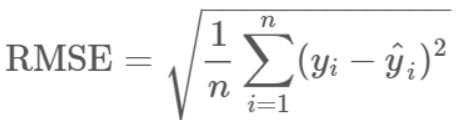

Root mean square error can be expressed as above, where N is the number of data points, y(i) is the i-th measurement, and y ̂^(i) is its corresponding prediction.


#### Precision@k
Precision@k is the proportion of recommended items in the top-k set that are relevant.
We can say that,

Precision@k = (No. of recommended items @k that are relevant) / (No. of recommended items @k)


For instance, Precision@10 calculated here, corresponds to the number of relevant results among the top 10 retrieved recommendations. This metric is chosen as it is easier to score manually since only the top k results need to be examined to determine if they are relevant or not.


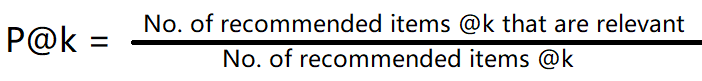

Above formula for understanding precision@k in top-k set.

There are various other evaluation models including MAE, MAP@k, recall@k and so on that could also bring some insights to the receommendation model